In [27]:
nbqa pylint 'http://localhost:8888/edit/patterns/patterns/pattern_or_coincidence/src/models/predicting.py'

SyntaxError: invalid syntax (1593251466.py, line 1)

# import data

## import libs

In [1]:
import numpy as np
import os
import random
from tslearn.clustering import KShape
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

import pandas as pd
import copy

from datetime import datetime

%matplotlib inline
import matplotlib.pylab as plt

## import from csv

In [2]:
df = pd.read_csv("../data/raw/minutes_21.csv")
df["begin"] = pd.to_datetime(df["begin"])
df.head()

,begin,open,close,high,low,value
0,2021-01-04 09:59:00,274.67,274.67,274.67,274.67,33910758.2
1,2021-01-04 10:00:00,274.67,274.00,274.67,273.10,236436377.8
2,2021-01-04 10:01:00,274.00,273.77,274.44,273.72,56647825.9
3,2021-01-04 10:02:00,273.76,273.63,273.84,273.38,55542122.2
4,2021-01-04 10:03:00,273.52,273.71,274.00,273.52,59676343.0


## import from stock market (not necessarily)

In [4]:
import requests
import apimoex
import pandas as pd

from datetime import datetime

%matplotlib inline
import matplotlib.pylab as plt

import plotly
import plotly.graph_objects as go

ModuleNotFoundError: No module named 'apimoex'

In [24]:
with requests.Session() as session:
    data = apimoex.get_board_history(session, "SBER")
    df = pd.DataFrame(data)
    df["TRADEDATE"] = pd.to_datetime(df["TRADEDATE"])
    df.set_index("TRADEDATE", inplace=True)

In [27]:
df.loc["2021"].head()

,BOARDID,CLOSE,VOLUME,VALUE
TRADEDATE,,,,
2021-01-04,TQBR,272.00,48922920,1.343454e+10
2021-01-05,TQBR,275.20,45583910,1.244994e+10
2021-01-06,TQBR,272.93,40948520,1.119879e+10
2021-01-08,TQBR,283.64,88928790,2.496560e+10
2021-01-11,TQBR,289.49,112349520,3.238759e+10


In [30]:
df.loc["2021"].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 255 entries, 2021-01-04 to 2021-12-30
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   BOARDID  255 non-null    object 
 1   CLOSE    255 non-null    float64
 2   VOLUME   255 non-null    int64  
 3   VALUE    255 non-null    float64
dtypes: float64(2), int64(1), object(1)
memory usage: 10.0+ KB


MOEX ISS формирует свечки в формате HLOCV, при этом используются следующие условные числовые коды:

1 - 1 минута

10 - 10 минут

60 - 1 час

24 - 1 день

7 - 1 неделя

31 - 1 месяц

4 - 1 квартал

In [37]:
# Поминутки (interval=1)

with requests.Session() as session:
    data = apimoex.get_market_candles(
        session, "SBER", interval=1, start="2021-01-01", end="2021-12-31"
    )
    candles = pd.DataFrame(data)
    candles["begin"] = pd.to_datetime(candles["begin"])
    candles.set_index("begin", inplace=True)


display(candles.head())
candles.info()

,open,close,high,low,value
begin,,,,,
2021-01-04 09:59:00,274.67,274.67,274.67,274.67,33910758.2
2021-01-04 10:00:00,274.67,274.00,274.67,273.10,236436377.8
2021-01-04 10:01:00,274.00,273.77,274.44,273.72,56647825.9
2021-01-04 10:02:00,273.76,273.63,273.84,273.38,55542122.2
2021-01-04 10:03:00,273.52,273.71,274.00,273.52,59676343.0


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 210360 entries, 2021-01-04 09:59:00 to 2021-12-30 23:49:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   open    210360 non-null  float64
 1   close   210360 non-null  float64
 2   high    210360 non-null  float64
 3   low     210360 non-null  float64
 4   value   210360 non-null  float64
dtypes: float64(5)
memory usage: 9.6 MB


In [35]:
fig = go.Figure(
    data=[
        go.Candlestick(
            x=candles.index,
            open=candles["open"],
            high=candles["high"],
            low=candles["low"],
            close=candles["close"],
        )
    ]
)

fig.update_layout(xaxis_rangeslider_visible=False)
fig.show()

In [43]:
candles.to_csv("minutes_21.csv")

# preprocess data

## inflation (not neccesarily)

в 2021 можно пренебречь, отклонение несильное, 

- как в рамках потребительских цен: https://tradingeconomics.com/russia/inflation-cpi
- так и в рамках доллара: https://tradingeconomics.com/russia/currency

## добавляем данные по rolling mean

In [ ]:
roll_period = 5
df["rolling_open"] = df.open.rolling(roll_period).mean()
df.dropna(axis=0, inplace=True)

## splitting function

In [3]:
def data_division(data, column_time='begin', column_value='open', period=60, step=10, part_len=100):
    """Разбиваем строго внутри дня, по {period} минут, с шагом {step}. Потом достаем {part_len} рандомных временных рядов.

    Args:
        data (DataFrame): should have column_time and column_value.
        period (int, optional): the size of division. Defaults to 60.
        step (int, optional): step in dividing. when step=period, the dividing is consequential (elements are not repeated). Defaults to 10.
        part_len (int, optional): the size of random sample out of all divisions. Defaults to 100. 

    Returns:
        DataFrame: random sample of time series. standardized by TimeSeriesScalerMeanVariance().
    """

    df_open = data[[column_time, column_value]]
    df_grouped = df_open.groupby([df_open[column_time].dt.date])
    full_range = []

    for dates in list(df_grouped.groups.keys()):
        df_day = df_grouped.get_group(dates)
        my_list = list(df_day[column_value])
        composite_list = [
            my_list[x : x + period] for x in range(0, len(my_list)-period+1, step)
        ]
        # drop last if it doesn't have full period
        #if len(composite_list[:-1]) != period: composite_list = composite_list[:-1]
        
        full_range += composite_list

    new_df = pd.DataFrame(full_range)
    print('the size of initial sample: {0}'.format(new_df.shape))

    # lets start with small part

    np.random.seed(0)
    new_df = new_df.iloc[list(np.random.choice(range(len(new_df)), part_len, replace=False))]
    df_norm = TimeSeriesScalerMeanVariance().fit_transform(new_df.values)

    print('the size of random sample: {0}'.format(df_norm.shape))
    print('\npreview of 1 time series:')
    print(df_norm[0])

    return df_norm

In [77]:
df_normed = data_division(df)

the size of initial sample: (19714, 60)
the size of random sample: (100, 60, 1)

preview of 1 time series:
[[ 0.51941731]
 [ 1.52150857]
 [ 1.52150857]
 [ 1.42129944]
 [ 1.72192682]
 [ 1.22088119]
 [ 1.22088119]
 [ 0.82004468]
 [ 0.51941731]
 [ 0.1185808 ]
 [-0.38246483]
 [-0.58288309]
 [-0.88351046]
 [-0.78330134]
 [-0.58288309]
 [-0.28225571]
 [ 0.1185808 ]
 [-0.18204658]
 [-0.28225571]
 [-0.28225571]
 [-0.38246483]
 [-0.58288309]
 [-0.48267396]
 [-0.48267396]
 [-0.78330134]
 [-0.98371959]
 [-0.48267396]
 [-0.48267396]
 [-0.98371959]
 [-1.08392872]
 [-1.88560173]
 [-1.7853926 ]
 [-1.08392872]
 [-1.98581085]
 [-1.98581085]
 [-2.18622911]
 [-1.3845561 ]
 [ 0.1185808 ]
 [ 0.61962643]
 [ 0.61962643]
 [ 0.61962643]
 [-0.48267396]
 [ 0.41920818]
 [ 1.52150857]
 [ 1.02046294]
 [ 0.31899905]
 [ 1.82213595]
 [ 1.02046294]
 [ 0.61962643]
 [ 1.02046294]
 [ 0.92025381]
 [ 0.1185808 ]
 [-0.88351046]
 [-0.88351046]
 [ 0.71983556]
 [ 0.51941731]
 [ 0.82004468]
 [ 0.82004468]
 [ 0.51941731]
 [ 0.619

## данные по среднему между open и close ?

## standardization (not neccesarily)

In [11]:
new_df.values

array([[271.18, 271.15, 271.06, ..., 271.04, 271.  , 271.18],
       [302.89, 302.81, 303.1 , ..., 303.05, 303.11, 303.15],
       [311.92, 311.93, 312.06, ..., 312.05, 312.01, 312.  ],
       ...,
       [368.54, 368.6 , 368.59, ..., 368.62, 368.75, 368.74],
       [321.54, 321.54, 321.52, ..., 321.75, 321.86, 321.93],
       [292.32, 292.43, 292.6 , ..., 292.62, 292.63, 292.67]])

In [19]:
new_df.values.shape

(1000, 10)

In [15]:
TimeSeriesScalerMeanVariance().fit_transform(new_df.values).shape

(1000, 10, 1)

если хотим чтобы сильный разброс в одном отрезке считался таким же значимым, как слабый разброс в другом, но с тем же направлением, то надо делать стандартизацию по каждому отрезку отдельно

если же лучше учитывать сильные отклонения относительно всего временного ряда, то сначала стандартизуем, а потом возвращаем разбиение по отрезкам

In [176]:
np.array([[2, 1, 2], [10, 1, 10], [-100, 0, 3]]).flatten().reshape((3, 3))

array([[   2,    1,    2],
       [  10,    1,   10],
       [-100,    0,    3]])

In [187]:
TimeSeriesScalerMeanVariance().fit_transform(
    np.array([[2, 1, 2], [10, 1, 10], [-100, 0, 3]]).flatten().reshape(1, -1)
).reshape((3, 3, 1))

array([[[ 0.30185972],
        [ 0.27133458],
        [ 0.30185972]],

       [[ 0.54606084],
        [ 0.27133458],
        [ 0.54606084]],

       [[-2.8117046 ],
        [ 0.24080944],
        [ 0.33238486]]])

In [179]:
TimeSeriesScalerMeanVariance().fit_transform(
    np.array([[2, 1, 2], [10, 1, 10], [-100, 0, 3]])
)

array([[[ 0.70710678],
        [-1.41421356],
        [ 0.70710678]],

       [[ 0.70710678],
        [-1.41421356],
        [ 0.70710678]],

       [[-1.4137505 ],
        [ 0.67553595],
        [ 0.73821454]]])

# clustering (without functions)

## period = 60

In [28]:
# разбиваем строго внутри дня, по {period} минут, последовательно

period = 60

df_open = df[["begin", "open"]]
df_grouped = df_open.groupby([df_open["begin"].dt.date])
full_range = []

for dates in list(df_grouped.groups.keys()):
    df_day = df_grouped.get_group(dates)
    my_list = list(df_day["open"])
    composite_list = [
        my_list[x : x + period] for x in range(0, len(my_list), period)
    ]
    # drop last cause not sure if it has full period
    composite_list = composite_list[:-1]
    full_range += composite_list

new_df = pd.DataFrame(full_range)

# lets start with small part

np.random.seed(0)
new_df = new_df.iloc[list(np.random.choice(range(len(new_df)), 1000))]
new_df.head()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
2732,370.61,370.24,370.05,369.94,370.33,370.73,370.97,370.80,370.47,370.46,...,368.36,368.25,368.05,367.91,367.95,367.87,367.61,368.03,367.93,368.28
2607,374.77,374.67,374.83,374.75,374.91,375.54,375.52,375.70,375.49,375.60,...,377.10,377.20,377.20,377.20,376.81,377.09,376.88,376.91,376.92,377.23
1653,305.34,305.28,305.21,305.11,305.08,305.15,305.06,305.02,305.10,305.03,...,305.38,305.40,305.45,305.44,305.45,305.46,305.49,305.38,305.50,305.47
3264,291.61,291.55,291.69,291.64,292.03,292.45,292.72,293.27,293.95,293.81,...,293.82,294.20,294.03,294.12,294.06,293.78,293.61,293.65,293.80,293.72
835,285.13,285.06,285.20,285.36,285.18,285.19,285.20,285.26,285.44,285.46,...,284.60,284.58,284.55,284.77,284.81,284.76,284.58,284.49,284.60,284.42


0.079 --> 0.076 --> 0.075 --> 0.074 --> 0.073 --> 0.072 --> 0.072 --> 0.072 --> 


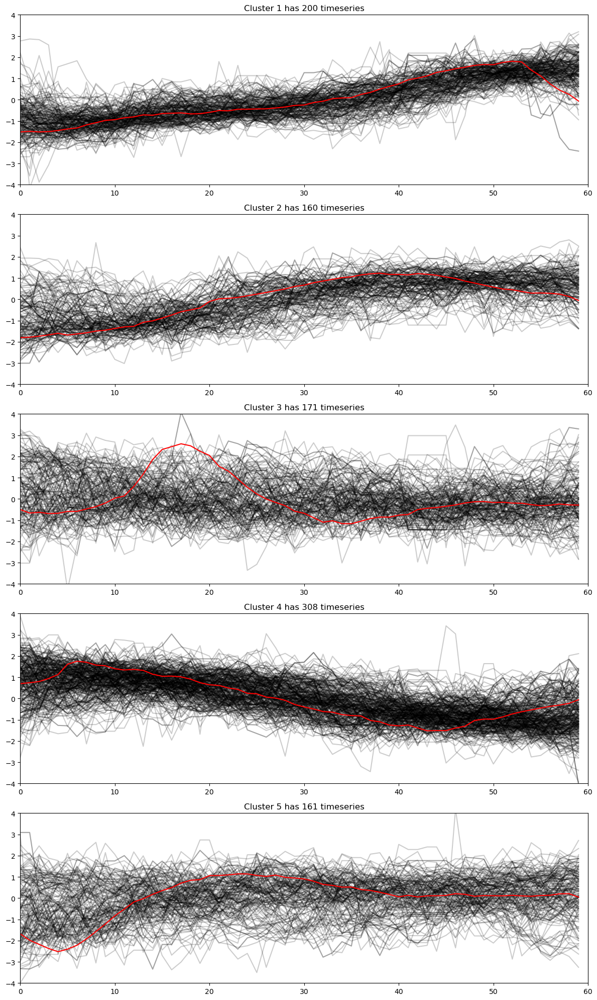

In [6]:
# число кластеров, надо подбирать
nc = 5

# здесь делаю отдельную стандартизацию для каждого отрезка (см. ##standardization)
X_train = TimeSeriesScalerMeanVariance().fit_transform(new_df.values)
sz = X_train.shape[1]

np.random.seed(0)

# kShape
ks = KShape(n_clusters=nc, verbose=True, random_state=seed)
y_pred = ks.fit_predict(X_train)

# plot
plt.figure(figsize=(12, nc * 4))
for yi in range(nc):
    plt.subplot(nc, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.title(
        f"Cluster {str(yi + 1)} has {str(X_train[y_pred == yi].shape[0])} timeseries"
    )

plt.tight_layout()
plt.show()

## period = 60 (shared standardization - fail)

не работает, за час данные очень слабо изменяются относительно целого года

Resumed because of empty cluster
Resumed because of empty cluster
0.751 --> 0.650 --> Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster
Resumed because of empty cluster


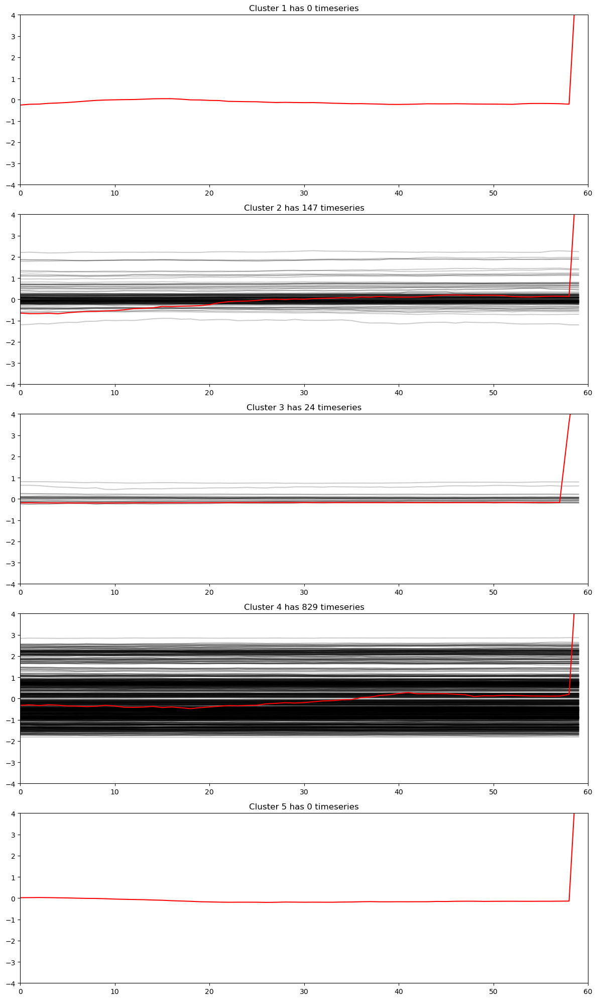

In [23]:
# число кластеров, надо подбирать
nc = 5

# здесь делаю общую стандартизацию для каждого отрезка (см. ##standardization)

X_train = (
    TimeSeriesScalerMeanVariance()
    .fit_transform(new_df.values.flatten().reshape(1, -1))
    .reshape((new_df.shape[0], new_df.shape[1], 1))
)
sz = X_train.shape[1]

np.random.seed(0)

# kShape
ks = KShape(n_clusters=nc, verbose=True, random_state=seed)
y_pred = ks.fit_predict(X_train)

# plot
plt.figure(figsize=(12, nc * 4))
for yi in range(nc):
    plt.subplot(nc, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.title(
        f"Cluster {str(yi + 1)} has {str(X_train[y_pred == yi].shape[0])} timeseries"
    )

plt.tight_layout()
plt.show()

## period = 10

In [29]:
# разбиваем строго внутри дня, по {period} минут, последовательно

period = 10

df_open = df[["begin", "open"]]
df_grouped = df_open.groupby([df_open["begin"].dt.date])
full_range = []

for dates in list(df_grouped.groups.keys()):
    df_day = df_grouped.get_group(dates)
    my_list = list(df_day["open"])
    composite_list = [
        my_list[x : x + period] for x in range(0, len(my_list), period)
    ]
    # drop last cause not sure if it has full period
    composite_list = composite_list[:-1]
    full_range += composite_list

new_df = pd.DataFrame(full_range)

# lets start with small part

np.random.seed(0)
new_df = new_df.iloc[list(np.random.choice(range(len(new_df)), 1000))]
new_df.head()

,0,1,2,3,4,5,6,7,8,9
2732,271.18,271.15,271.06,271.01,271.01,270.88,270.83,271.04,271.00,271.18
10799,302.89,302.81,303.10,303.10,303.23,303.17,303.06,303.05,303.11,303.15
9845,311.92,311.93,312.06,312.11,312.10,312.00,312.02,312.05,312.01,312.00
19648,286.11,285.74,285.77,285.14,284.60,284.81,284.70,284.85,284.90,284.50
13123,328.39,328.57,328.63,328.64,328.71,328.72,328.62,328.65,328.61,328.67


0.081 --> 0.082 --> 


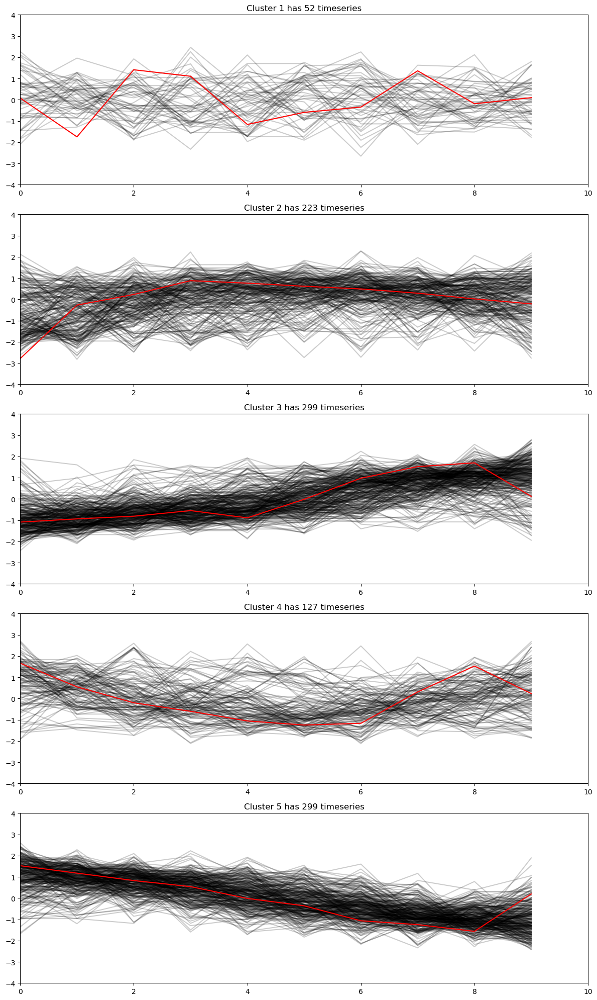

In [9]:
# число кластеров, надо подбирать
nc = 5

# здесь делаю отдельную стандартизацию для каждого отрезка (см. ##standardization)
X_train = TimeSeriesScalerMeanVariance().fit_transform(new_df.values)
sz = X_train.shape[1]

np.random.seed(0)

# kShape
ks = KShape(n_clusters=nc, verbose=True, random_state=seed)
y_pred = ks.fit_predict(X_train)

# plot
plt.figure(figsize=(12, nc * 4))
for yi in range(nc):
    plt.subplot(nc, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.title(
        f"Cluster {str(yi + 1)} has {str(X_train[y_pred == yi].shape[0])} timeseries"
    )

plt.tight_layout()
plt.show()

## period = 30

In [30]:
# разбиваем строго внутри дня, по {period} минут, последовательно

period = 30

df_open = df[["begin", "open"]]
df_grouped = df_open.groupby([df_open["begin"].dt.date])
full_range = []

for dates in list(df_grouped.groups.keys()):
    df_day = df_grouped.get_group(dates)
    my_list = list(df_day["open"])
    composite_list = [
        my_list[x : x + period] for x in range(0, len(my_list), period)
    ]
    # drop last cause not sure if it has full period
    composite_list = composite_list[:-1]
    full_range += composite_list

new_df = pd.DataFrame(full_range)

# lets start with small part

np.random.seed(0)
new_df = new_df.iloc[list(np.random.choice(range(len(new_df)), 1000))]
new_df.head()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
2732,310.01,309.83,309.57,309.85,310.12,310.25,310.10,310.08,310.12,310.16,...,310.18,310.18,310.25,310.23,309.88,310.04,310.01,309.88,310.05,310.11
2607,301.32,301.32,301.27,301.16,301.25,301.50,301.46,301.33,301.30,301.40,...,301.35,301.40,301.50,301.56,301.54,301.58,301.56,301.55,301.59,301.54
1653,291.90,291.90,292.01,291.94,292.04,292.04,292.07,292.02,292.10,292.03,...,292.15,292.24,292.16,292.18,292.07,292.00,291.89,291.96,291.95,291.92
3264,312.26,312.26,312.14,312.01,311.98,311.96,312.01,312.29,312.32,312.23,...,311.88,311.97,311.88,312.00,312.07,312.07,311.91,311.98,312.00,312.02
4931,324.40,324.58,324.45,324.34,323.73,324.04,324.17,324.14,324.21,324.32,...,324.63,324.70,324.62,324.50,324.53,324.60,324.51,324.53,324.54,324.50


0.091 --> 0.083 --> 0.082 --> 0.081 --> 0.081 --> 0.081 --> 


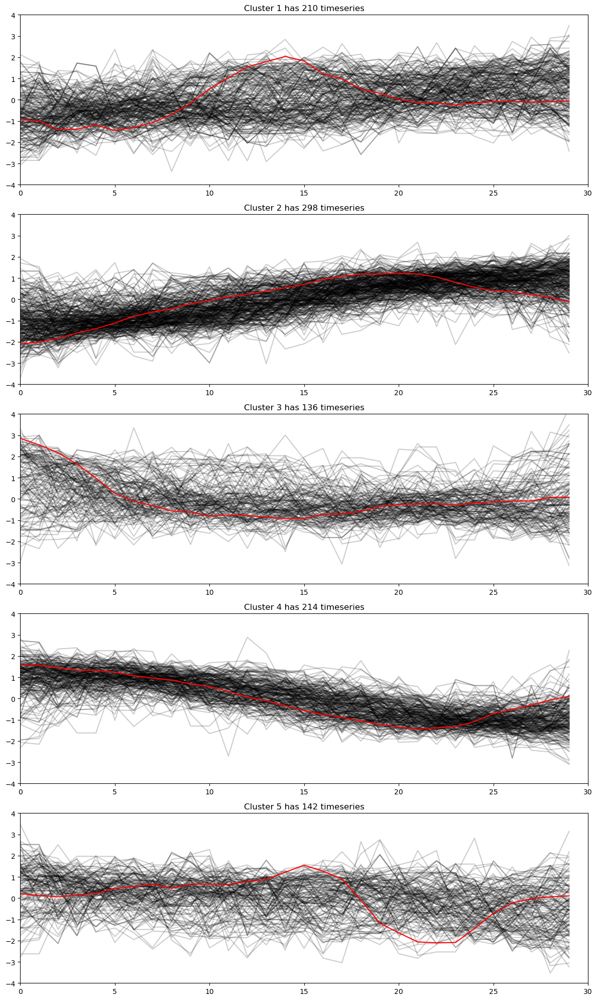

In [31]:
# число кластеров, надо подбирать
nc = 5

# здесь делаю отдельную стандартизацию для каждого отрезка (см. ##standardization)
X_train = TimeSeriesScalerMeanVariance().fit_transform(new_df.values)
sz = X_train.shape[1]

np.random.seed(0)

# kShape
ks = KShape(n_clusters=nc, verbose=True, random_state=seed)
y_pred = ks.fit_predict(X_train)

# plot
plt.figure(figsize=(12, nc * 4))
for yi in range(nc):
    plt.subplot(nc, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.title(
        f"Cluster {str(yi + 1)} has {str(X_train[y_pred == yi].shape[0])} timeseries"
    )

plt.tight_layout()
plt.show()

# clustering (with functions)

In [5]:
def data_division(data, column_time='begin', column_value='open', period=60, step=10, part_len=100):
    """Разбиваем строго внутри дня, по {period} минут, с шагом {step}. Потом достаем {part_len} рандомных временных рядов.

    Args:
        data (DataFrame): should have column_time and column_value.
        period (int, optional): the size of division. Defaults to 60.
        step (int, optional): step in dividing. when step=period, the dividing is consequential (elements are not repeated). Defaults to 10.
        part_len (int, optional): the size of random sample out of all divisions. Defaults to 100. 

    Returns:
        DataFrame: random sample of time series. standardized by TimeSeriesScalerMeanVariance().
    """

    df_open = data[[column_time, column_value]]
    df_grouped = df_open.groupby([df_open[column_time].dt.date])
    full_range = []

    for dates in list(df_grouped.groups.keys()):
        df_day = df_grouped.get_group(dates)
        my_list = list(df_day[column_value])
        composite_list = [
            my_list[x : x + period] for x in range(0, len(my_list)-period+1, step)
        ]
        # drop last if it doesn't have full period
        #if len(composite_list[:-1]) != period: composite_list = composite_list[:-1]
        
        full_range += composite_list

    new_df = pd.DataFrame(full_range)
    print('the size of initial sample: {0}'.format(new_df.shape))

    # lets start with small part

    np.random.seed(0)
    new_df = new_df.iloc[list(np.random.choice(range(len(new_df)), part_len, replace=False))]
    df_norm = TimeSeriesScalerMeanVariance().fit_transform(new_df.values)

    print('the size of random sample: {0}'.format(df_norm.shape))
    print('\npreview of 1 time series:')
    print(df_norm[0])

    return df_norm

In [3]:
def kshape_cluster(data, n_clusters=100, plot_n_best=10, column_value='open', period=30, rolling_period=6, train_sample=1000, column_time='begin', step=10):
    # rolling_period=1 если не нужно усреднять
    # step=period если не нужно повторяющихся элементов в выборках
    
    # prepare train sample
    df['new_col'] = df[column_value].rolling(rolling_period).mean()
    df.dropna(axis=0, inplace=True)
    np.random.seed(0)
    df_normed = data_division(data, column_time, 'new_col', period, step, train_sample)
    
    # если не задать, будут разные результаты
    np.random.seed(0)
    
    # kShape
    ks = KShape(n_clusters=n_clusters, verbose=True, n_init=3, random_state=0)
    y_pred = ks.fit_predict(df_normed)
    
    # best
    std_cl = []
    for i in range(n_clusters):
        centr = ks.cluster_centers_[i].ravel()
        all_ts = []
        for j in range(len(df_normed[y_pred==i])):
            print(df_normed[y_pred==i])
            print(df_normed[y_pred==i][j])
            ts = df_normed[y_pred==i][j].ravel()
            all_ts += [list(ts)]
        all_avg = np.array(pd.DataFrame(all_ts).mean(axis=0))
        diff = (centr-all_avg)**2
        std = (np.sum(diff)/(len(diff)-1))**(1/2)
        std_cl.append(std)

    best = list(np.argsort(std_cl)[:plot_n_best])

    # plot

    # длина временного ряда
    sz = df_normed.shape[1]
    # число кластеров
    nc = len(best)

    plt.figure(figsize=(12, nc * 4))
    for (yi, cl) in enumerate(best):
        plt.subplot(nc, 1, 1 + yi)
        for xx in df_normed[y_pred == cl]:
            plt.plot(xx.ravel(), "k-", alpha=0.2)
        plt.plot(ks.cluster_centers_[cl].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.title(
            f"Cluster {str(cl)} has {str(df_normed[y_pred == cl].shape[0])} timeseries and std is %.2f"%std_cl[cl]
        )

    plt.tight_layout()
    plt.show()
    
    return ks

In [11]:
df_normed = data_division(df, column_time='begin', column_value='open', period=30, step=10, part_len=2000)

the size of initial sample: (20479, 30)
the size of random sample: (2000, 30, 1)

preview of 1 time series:
[[ 1.37704781]
 [ 1.37704781]
 [ 1.50913873]
 [ 1.44309327]
 [ 1.14588871]
 [ 1.01379779]
 [ 0.81566141]
 [ 0.55147958]
 [ 0.55147958]
 [ 0.25427502]
 [ 0.22125229]
 [-0.04292955]
 [ 0.32032047]
 [ 0.45241139]
 [ 0.3533432 ]
 [-0.07595228]
 [-0.14199774]
 [ 0.22125229]
 [ 0.08916137]
 [ 0.08916137]
 [-0.14199774]
 [-0.4392023 ]
 [-0.60431595]
 [-0.76942959]
 [-0.83547505]
 [-1.16570234]
 [-1.85917966]
 [-1.89220239]
 [-1.76011147]
 [-2.05731603]]


In [9]:
n_clusters=model.cluster_centers_.shape[0]

In [14]:
y_pred = model.predict(df_normed)

In [17]:
std_cl = []
for i in range(n_clusters):
    centr = model.cluster_centers_[i].ravel()
    all_ts = []
    for j in range(len(df_normed[y_pred==i])):
        ts = df_normed[y_pred==i][j].ravel()
        all_ts += [list(ts)]
    all_avg = np.array(pd.DataFrame(all_ts).mean(axis=0))
    diff = (centr-all_avg)**2
    std = (np.sum(diff)/(len(diff)-1))**(1/2)
    std_cl.append(std)

best = list(np.argsort(std_cl)[:5])

In [25]:
model.cluster_centers_[1].ravel()

array([-0.71923303, -0.82233091, -0.89933463, -0.94076234, -0.97585637,
       -0.98306198, -0.96020425, -0.94770645, -0.92937544, -0.91475738,
       -0.8772017 , -0.86797292, -0.79462557, -0.70144893, -0.5539051 ,
       -0.38627192, -0.15765049,  0.11953017,  0.37849186,  0.6649927 ,
        0.95744102,  1.23778943,  1.44655359,  1.59899374,  1.69609331,
        1.71844921,  1.66824871,  1.3912724 ,  0.54742609,  0.00641717])

In [18]:
df_normed[y_pred==1]

array([[[-1.22096543],
        [-0.76688738],
        [-0.84256706],
        ...,
        [ 0.02774921],
        [-0.04793046],
        [ 0.25478824]],

       [[-1.31245606],
        [-1.16415594],
        [-1.31245606],
        ...,
        [ 0.76374562],
        [ 0.68959556],
        [ 0.46714538]],

       [[-0.15761222],
        [ 0.1524446 ],
        [-0.23512642],
        ...,
        [ 1.70272869],
        [ 1.31515767],
        [ 1.16012926]],

       ...,

       [[-1.00524698],
        [-1.32607049],
        [-1.00524698],
        ...,
        [ 0.85552935],
        [ 0.40637644],
        [ 0.27804704]],

       [[ 0.28368741],
        [-0.05056664],
        [-1.41329469],
        ...,
        [ 1.62070361],
        [ 1.56927991],
        [ 1.80068656]],

       [[ 0.19595972],
        [ 0.29201841],
        [-0.09221634],
        ...,
        [ 1.71368698],
        [ 1.69447524],
        [ 1.15654659]]])

the size of initial sample: (20479, 30)
the size of random sample: (2000, 30, 1)

preview of 1 time series:
[[ 1.20878036]
 [ 1.20878036]
 [ 1.39768622]
 [ 1.40420022]
 [ 1.33254627]
 [ 1.23483634]
 [ 1.12409843]
 [ 0.96124855]
 [ 0.77234269]
 [ 0.53783886]
 [ 0.355447  ]
 [ 0.14699916]
 [ 0.04928923]
 [ 0.02974724]
 [-0.00933673]
 [-0.07447668]
 [-0.14613062]
 [-0.09401866]
 [-0.13961663]
 [-0.21127058]
 [-0.3089805 ]
 [-0.38063445]
 [-0.47183038]
 [-0.66725023]
 [-0.8496421 ]
 [-1.09717391]
 [-1.43590166]
 [-1.72251744]
 [-1.95050727]
 [-2.20455308]]
Init 1
0.015 --> 0.015 --> 0.015 --> 
Init 2
Resumed because of empty cluster
Init 2
Resumed because of empty cluster
Init 2
0.013 --> 0.013 --> 
Init 3
0.014 --> 0.013 --> 0.014 --> 
[[[-0.359817  ]
  [ 0.19851972]
  [ 0.6451891 ]
  ...
  [-1.2903782 ]
  [-0.80648637]
  [ 0.31018707]]

 [[-0.27313845]
  [ 0.34434358]
  [ 0.84500469]
  ...
  [-0.40664808]
  [-0.69035604]
  [-0.85724308]]

 [[ 0.10348277]
  [-0.42227648]
  [-0.69767418]
 

[[[-1.57952084]
  [-1.49745766]
  [-1.29816136]
  ...
  [ 0.95271445]
  [ 0.68307828]
  [ 0.51895192]]

 [[-1.20173859]
  [-1.04494463]
  [-0.8986036 ]
  ...
  [ 1.4951175 ]
  [ 1.62055267]
  [ 1.72508198]]

 [[-1.32652479]
  [-1.24036017]
  [-1.22805094]
  ...
  [ 1.28303217]
  [ 1.14763063]
  [ 1.03684755]]

 ...

 [[-1.24686954]
  [-0.72243662]
  [-0.7951303 ]
  ...
  [ 1.73876338]
  [ 1.73876338]
  [ 1.93088236]]

 [[-0.09624017]
  [-0.45865086]
  [-0.70025798]
  ...
  [ 1.30508114]
  [ 0.90642939]
  [ 0.53193835]]

 [[-0.92093713]
  [-1.02116003]
  [-1.14365469]
  ...
  [ 0.88307514]
  [ 0.69376521]
  [ 0.67149345]]]
[[-0.23726514]
 [-0.59390584]
 [-0.86138637]
 [-1.03970673]
 [-0.95054655]
 [-0.96540658]
 [-0.89110643]
 [-0.84652635]
 [-0.89110643]
 [-0.95054655]
 [-0.96540658]
 [-1.03970673]
 [-0.98026661]
 [-0.93568652]
 [-0.8762464 ]
 [-0.54932576]
 [-0.22240511]
 [ 0.16395566]
 [ 0.43143619]
 [ 0.72863678]
 [ 1.15957763]
 [ 1.42705816]
 [ 1.57565846]
 [ 1.57565846]
 [ 1.62023

[[-1.27798823]
 [-0.94842107]
 [-0.72870962]
 [-1.02165821]
 [-0.94842107]
 [-0.80194677]
 [-0.69209105]
 [-0.58223533]
 [ 0.00366186]
 [ 0.58955904]
 [ 1.0656005 ]
 [ 0.69941476]
 [ 0.77265191]
 [ 0.80927049]
 [ 0.3698476 ]
 [-0.06957529]
 [-0.43576103]
 [-0.54561675]
 [-0.69209105]
 [-1.13151394]
 [-1.20475108]
 [-0.98503964]
 [-0.72870962]
 [-0.17943101]
 [ 0.2233733 ]
 [ 1.02898193]
 [ 1.68811626]
 [ 1.76135341]
 [ 1.87120913]
 [ 2.09092057]]
[[[-2.08306067]
  [-1.94150177]
  [-1.91576378]
  ...
  [ 0.6580344 ]
  [ 0.70951037]
  [ 0.92828321]]

 [[-0.25167569]
  [-0.90282839]
  [-1.33693019]
  ...
  [ 1.43822062]
  [ 2.1668915 ]
  [ 2.33743149]]

 [[-2.64912721]
  [-2.09735899]
  [-1.57917665]
  ...
  [ 0.57032043]
  [ 0.68547206]
  [ 0.52713857]]

 ...

 [[-0.56075769]
  [-0.74494817]
  [-0.77564658]
  ...
  [ 0.97416299]
  [ 1.71092491]
  [ 2.04860746]]

 [[-2.04340972]
  [-1.65377651]
  [-1.13426556]
  ...
  [ 0.74896161]
  [ 0.65155331]
  [ 0.1645118 ]]

 [[-1.25972186]
  [-0.6

[[[-5.69320106e-01]
  [-8.25904608e-01]
  [-1.11595665e+00]
  [-1.24982683e+00]
  [-1.40600870e+00]
  [-9.82086479e-01]
  [-3.68514843e-01]
  [ 3.00836032e-01]
  [ 8.80940124e-01]
  [ 1.38295328e+00]
  [ 1.81803135e+00]
  [ 1.59491439e+00]
  [ 1.08174539e+00]
  [ 9.92498604e-01]
  [ 1.07058954e+00]
  [ 1.01481030e+00]
  [ 8.69784276e-01]
  [ 6.24355622e-01]
  [ 7.58225797e-01]
  [ 5.01641295e-01]
  [ 2.33900945e-01]
  [-3.71861597e-04]
  [-1.67709580e-01]
  [-8.96186450e-02]
  [-3.68514843e-01]
  [-6.25099345e-01]
  [-9.15151391e-01]
  [-1.23867098e+00]
  [-1.42832040e+00]
  [-1.77415168e+00]]

 [[-1.70497469e+00]
  [-1.32998026e+00]
  [-9.54985825e-01]
  [-5.98741113e-01]
  [ 5.74991465e-02]
  [ 7.32489127e-01]
  [ 8.26237736e-01]
  [ 7.51238849e-01]
  [ 7.88738292e-01]
  [ 1.05123440e+00]
  [ 8.82486901e-01]
  [ 7.32489127e-01]
  [ 7.88738292e-01]
  [ 9.57485787e-01]
  [ 6.76239962e-01]
  [ 2.63746085e-01]
  [-1.74997402e-02]
  [-1.86247235e-01]
  [-3.62494619e-02]
  [-1.29998070e-01

[[-1.42473461]
 [-0.96014724]
 [-0.45982237]
 [ 0.46935237]
 [ 1.00541472]
 [ 1.39852712]
 [ 1.79163951]
 [ 1.61295206]
 [ 1.39852712]
 [ 0.93393974]
 [ 0.50508986]
 [-0.03097249]
 [-0.31687241]
 [ 0.11197747]
 [ 0.04050249]
 [ 0.39787739]
 [ 0.93393974]
 [ 1.14836469]
 [ 0.75525229]
 [ 0.3621399 ]
 [ 0.004765  ]
 [-0.85293477]
 [-1.38899712]
 [-1.63915955]
 [-1.4604721 ]
 [-1.31752214]
 [-0.96014724]
 [-0.60277233]
 [-0.60277233]
 [-0.85293477]]
[[[-5.69320106e-01]
  [-8.25904608e-01]
  [-1.11595665e+00]
  [-1.24982683e+00]
  [-1.40600870e+00]
  [-9.82086479e-01]
  [-3.68514843e-01]
  [ 3.00836032e-01]
  [ 8.80940124e-01]
  [ 1.38295328e+00]
  [ 1.81803135e+00]
  [ 1.59491439e+00]
  [ 1.08174539e+00]
  [ 9.92498604e-01]
  [ 1.07058954e+00]
  [ 1.01481030e+00]
  [ 8.69784276e-01]
  [ 6.24355622e-01]
  [ 7.58225797e-01]
  [ 5.01641295e-01]
  [ 2.33900945e-01]
  [-3.71861597e-04]
  [-1.67709580e-01]
  [-8.96186450e-02]
  [-3.68514843e-01]
  [-6.25099345e-01]
  [-9.15151391e-01]
  [-1.238

[[[ 0.33864769]
  [ 0.32522704]
  [ 0.11049667]
  [-0.66790092]
  [-1.12420296]
  [-1.00341712]
  [-0.50685314]
  [-0.52027379]
  [-0.4397499 ]
  [ 0.02997278]
  [ 0.01655213]
  [-0.35922601]
  [-0.72158351]
  [-0.8289487 ]
  [-0.98999648]
  [-1.43287786]
  [-1.12420296]
  [-0.60079768]
  [ 0.13733797]
  [ 0.79494972]
  [ 1.25125176]
  [ 1.76123639]
  [ 1.80149833]
  [ 1.97596676]
  [ 1.53308537]
  [ 1.318355  ]
  [ 0.99625945]
  [ 0.17759991]
  [-0.78868675]
  [-1.45971916]]

 [[-1.580699  ]
  [-1.27755873]
  [-0.88429567]
  [-0.53199752]
  [-0.17150639]
  [-0.00764678]
  [-0.06499764]
  [-0.22066427]
  [-0.31898003]
  [-0.4582607 ]
  [-0.67127819]
  [-0.55657646]
  [-0.44187474]
  [-0.26982215]
  [ 0.06609004]
  [ 0.60682674]
  [ 1.2458792 ]
  [ 1.64733524]
  [ 1.84396676]
  [ 1.90951061]
  [ 1.7866159 ]
  [ 1.45889669]
  [ 1.04924768]
  [ 0.38561627]
  [ 0.10705494]
  [-0.27801513]
  [-0.72043607]
  [-0.9989974 ]
  [-1.31033065]
  [-1.34310257]]

 [[-1.66537207]
  [-1.64960772]
  [-

[[-1.28975413]
 [-0.95439011]
 [-0.49326458]
 [-0.28366207]
 [-0.28366207]
 [-0.45134408]
 [-0.40942358]
 [-0.32558257]
 [-0.36750307]
 [-0.40942358]
 [-0.32558257]
 [-0.40942358]
 [-0.45134408]
 [-0.61902609]
 [-0.7028671 ]
 [-1.03823112]
 [-1.03823112]
 [-0.95439011]
 [-1.12207212]
 [-0.8286286 ]
 [-0.11598006]
 [ 0.59666849]
 [ 1.01587352]
 [ 1.30931703]
 [ 1.85428357]
 [ 1.98004508]
 [ 1.56084005]
 [ 1.43507854]
 [ 1.43507854]
 [ 1.68660156]]
[[[ 0.33864769]
  [ 0.32522704]
  [ 0.11049667]
  [-0.66790092]
  [-1.12420296]
  [-1.00341712]
  [-0.50685314]
  [-0.52027379]
  [-0.4397499 ]
  [ 0.02997278]
  [ 0.01655213]
  [-0.35922601]
  [-0.72158351]
  [-0.8289487 ]
  [-0.98999648]
  [-1.43287786]
  [-1.12420296]
  [-0.60079768]
  [ 0.13733797]
  [ 0.79494972]
  [ 1.25125176]
  [ 1.76123639]
  [ 1.80149833]
  [ 1.97596676]
  [ 1.53308537]
  [ 1.318355  ]
  [ 0.99625945]
  [ 0.17759991]
  [-0.78868675]
  [-1.45971916]]

 [[-1.580699  ]
  [-1.27755873]
  [-0.88429567]
  [-0.53199752]
  [

[[-1.49496034]
 [-2.05047821]
 [-1.86530559]
 [-1.45792581]
 [-1.08758056]
 [-0.60613173]
 [-0.71723531]
 [-0.34689005]
 [-0.38392458]
 [-0.38392458]
 [-0.4209591 ]
 [-0.5690972 ]
 [-0.30985553]
 [-0.30985553]
 [-0.1246829 ]
 [ 0.09752425]
 [ 0.39380045]
 [ 0.65304213]
 [ 0.98635286]
 [ 1.31966358]
 [ 1.43076716]
 [ 1.57890526]
 [ 1.65297431]
 [ 1.43076716]
 [ 1.09745643]
 [ 0.7641457 ]
 [ 0.50490403]
 [ 0.1715933 ]
 [-0.16171743]
 [ 0.20862783]]
[[[ 0.33864769]
  [ 0.32522704]
  [ 0.11049667]
  [-0.66790092]
  [-1.12420296]
  [-1.00341712]
  [-0.50685314]
  [-0.52027379]
  [-0.4397499 ]
  [ 0.02997278]
  [ 0.01655213]
  [-0.35922601]
  [-0.72158351]
  [-0.8289487 ]
  [-0.98999648]
  [-1.43287786]
  [-1.12420296]
  [-0.60079768]
  [ 0.13733797]
  [ 0.79494972]
  [ 1.25125176]
  [ 1.76123639]
  [ 1.80149833]
  [ 1.97596676]
  [ 1.53308537]
  [ 1.318355  ]
  [ 0.99625945]
  [ 0.17759991]
  [-0.78868675]
  [-1.45971916]]

 [[-1.580699  ]
  [-1.27755873]
  [-0.88429567]
  [-0.53199752]
  [

[[[ 0.33864769]
  [ 0.32522704]
  [ 0.11049667]
  [-0.66790092]
  [-1.12420296]
  [-1.00341712]
  [-0.50685314]
  [-0.52027379]
  [-0.4397499 ]
  [ 0.02997278]
  [ 0.01655213]
  [-0.35922601]
  [-0.72158351]
  [-0.8289487 ]
  [-0.98999648]
  [-1.43287786]
  [-1.12420296]
  [-0.60079768]
  [ 0.13733797]
  [ 0.79494972]
  [ 1.25125176]
  [ 1.76123639]
  [ 1.80149833]
  [ 1.97596676]
  [ 1.53308537]
  [ 1.318355  ]
  [ 0.99625945]
  [ 0.17759991]
  [-0.78868675]
  [-1.45971916]]

 [[-1.580699  ]
  [-1.27755873]
  [-0.88429567]
  [-0.53199752]
  [-0.17150639]
  [-0.00764678]
  [-0.06499764]
  [-0.22066427]
  [-0.31898003]
  [-0.4582607 ]
  [-0.67127819]
  [-0.55657646]
  [-0.44187474]
  [-0.26982215]
  [ 0.06609004]
  [ 0.60682674]
  [ 1.2458792 ]
  [ 1.64733524]
  [ 1.84396676]
  [ 1.90951061]
  [ 1.7866159 ]
  [ 1.45889669]
  [ 1.04924768]
  [ 0.38561627]
  [ 0.10705494]
  [-0.27801513]
  [-0.72043607]
  [-0.9989974 ]
  [-1.31033065]
  [-1.34310257]]

 [[-1.66537207]
  [-1.64960772]
  [-

[[[ 0.96075207]
  [ 0.6746075 ]
  [ 0.44048921]
  ...
  [-0.62604963]
  [-0.31389192]
  [-0.10578678]]

 [[-0.29060702]
  [ 0.35832128]
  [ 0.89439248]
  ...
  [ 0.330107  ]
  [ 0.78153538]
  [ 0.92260675]]

 [[ 0.28982197]
  [ 0.04421013]
  [-0.2406996 ]
  ...
  [-1.11507776]
  [-1.11507776]
  [-1.20349802]]

 ...

 [[ 1.84862523]
  [ 1.65999   ]
  [ 1.32044659]
  ...
  [ 0.72938955]
  [ 0.55333   ]
  [ 0.4149975 ]]

 [[ 1.3505844 ]
  [ 1.29794469]
  [ 1.25282495]
  ...
  [-0.37524589]
  [-0.3376461 ]
  [-0.24740661]]

 [[ 0.72767474]
  [ 1.04132765]
  [ 1.02041745]
  ...
  [ 0.5185728 ]
  [ 0.79040532]
  [ 1.14587862]]]
[[-0.16678769]
 [-0.17727748]
 [-0.22972644]
 [-0.0199306 ]
 [ 0.14790607]
 [ 0.34721211]
 [ 0.56749775]
 [ 0.81925275]
 [ 1.21786485]
 [ 1.21786485]
 [ 1.44864027]
 [ 1.40668111]
 [ 1.32276277]
 [ 1.21786485]
 [ 0.97659963]
 [ 0.85072213]
 [ 0.55700795]
 [ 0.48357941]
 [ 0.16888565]
 [-0.13531832]
 [-0.35560395]
 [-0.62833854]
 [-0.92205272]
 [-1.16331793]
 [-1.27870

[[[-3.81851662e+00]
  [-2.40133519e+00]
  [-8.75139812e-01]
  [-2.21056077e-01]
  [ 2.14999746e-01]
  [ 6.51055569e-01]
  [ 6.14717584e-01]
  [ 2.69506724e-01]
  [ 1.24154783e-01]
  [-9.38731286e-02]
  [-5.75351433e-02]
  [-1.30211114e-01]
  [-1.12042121e-01]
  [-1.30211114e-01]
  [-6.57111900e-01]
  [-5.84435930e-01]
  [-3.48239025e-01]
  [ 1.60492768e-01]
  [ 5.60210606e-01]
  [ 8.32745496e-01]
  [ 1.26880132e+00]
  [ 1.21429434e+00]
  [ 1.19612535e+00]
  [ 9.41759451e-01]
  [ 4.69365643e-01]
  [ 1.78661761e-01]
  [-3.93661507e-02]
  [ 6.96478051e-02]
  [ 2.87675717e-01]
  [ 4.14858665e-01]]

 [[-2.21849525e+00]
  [-2.12610072e+00]
  [-1.57173356e+00]
  [-9.24971875e-01]
  [-1.24219308e-01]
  [ 3.37753326e-01]
  [ 5.84138731e-01]
  [ 7.22730521e-01]
  [ 6.61134170e-01]
  [ 3.99349677e-01]
  [ 1.06767009e-01]
  [ 1.37565184e-01]
  [ 2.29959711e-01]
  [ 3.06955150e-01]
  [ 4.60946028e-01]
  [ 7.38129609e-01]
  [ 9.07519575e-01]
  [ 9.84515014e-01]
  [ 1.23090042e+00]
  [ 1.23090042e+00

[[[-3.81851662e+00]
  [-2.40133519e+00]
  [-8.75139812e-01]
  [-2.21056077e-01]
  [ 2.14999746e-01]
  [ 6.51055569e-01]
  [ 6.14717584e-01]
  [ 2.69506724e-01]
  [ 1.24154783e-01]
  [-9.38731286e-02]
  [-5.75351433e-02]
  [-1.30211114e-01]
  [-1.12042121e-01]
  [-1.30211114e-01]
  [-6.57111900e-01]
  [-5.84435930e-01]
  [-3.48239025e-01]
  [ 1.60492768e-01]
  [ 5.60210606e-01]
  [ 8.32745496e-01]
  [ 1.26880132e+00]
  [ 1.21429434e+00]
  [ 1.19612535e+00]
  [ 9.41759451e-01]
  [ 4.69365643e-01]
  [ 1.78661761e-01]
  [-3.93661507e-02]
  [ 6.96478051e-02]
  [ 2.87675717e-01]
  [ 4.14858665e-01]]

 [[-2.21849525e+00]
  [-2.12610072e+00]
  [-1.57173356e+00]
  [-9.24971875e-01]
  [-1.24219308e-01]
  [ 3.37753326e-01]
  [ 5.84138731e-01]
  [ 7.22730521e-01]
  [ 6.61134170e-01]
  [ 3.99349677e-01]
  [ 1.06767009e-01]
  [ 1.37565184e-01]
  [ 2.29959711e-01]
  [ 3.06955150e-01]
  [ 4.60946028e-01]
  [ 7.38129609e-01]
  [ 9.07519575e-01]
  [ 9.84515014e-01]
  [ 1.23090042e+00]
  [ 1.23090042e+00

[[[-3.81851662e+00]
  [-2.40133519e+00]
  [-8.75139812e-01]
  [-2.21056077e-01]
  [ 2.14999746e-01]
  [ 6.51055569e-01]
  [ 6.14717584e-01]
  [ 2.69506724e-01]
  [ 1.24154783e-01]
  [-9.38731286e-02]
  [-5.75351433e-02]
  [-1.30211114e-01]
  [-1.12042121e-01]
  [-1.30211114e-01]
  [-6.57111900e-01]
  [-5.84435930e-01]
  [-3.48239025e-01]
  [ 1.60492768e-01]
  [ 5.60210606e-01]
  [ 8.32745496e-01]
  [ 1.26880132e+00]
  [ 1.21429434e+00]
  [ 1.19612535e+00]
  [ 9.41759451e-01]
  [ 4.69365643e-01]
  [ 1.78661761e-01]
  [-3.93661507e-02]
  [ 6.96478051e-02]
  [ 2.87675717e-01]
  [ 4.14858665e-01]]

 [[-2.21849525e+00]
  [-2.12610072e+00]
  [-1.57173356e+00]
  [-9.24971875e-01]
  [-1.24219308e-01]
  [ 3.37753326e-01]
  [ 5.84138731e-01]
  [ 7.22730521e-01]
  [ 6.61134170e-01]
  [ 3.99349677e-01]
  [ 1.06767009e-01]
  [ 1.37565184e-01]
  [ 2.29959711e-01]
  [ 3.06955150e-01]
  [ 4.60946028e-01]
  [ 7.38129609e-01]
  [ 9.07519575e-01]
  [ 9.84515014e-01]
  [ 1.23090042e+00]
  [ 1.23090042e+00

[[-2.91961193]
 [-2.42205551]
 [-1.51908275]
 [-0.56082594]
 [ 0.06572659]
 [ 0.58171102]
 [ 0.61856706]
 [ 0.87655927]
 [ 0.74756316]
 [ 0.39743087]
 [ 0.58171102]
 [ 0.74756316]
 [ 1.00555538]
 [ 1.0239834 ]
 [ 0.89498729]
 [ 0.87655927]
 [ 0.65542309]
 [ 0.45271492]
 [ 0.47114293]
 [ 0.28686278]
 [ 0.10258262]
 [ 0.21315071]
 [ 0.30529079]
 [ 0.4342869 ]
 [ 0.12101064]
 [-0.13698158]
 [-0.3949738 ]
 [-0.67139403]
 [-1.02152633]
 [-1.813931  ]]
[[[-3.81851662e+00]
  [-2.40133519e+00]
  [-8.75139812e-01]
  [-2.21056077e-01]
  [ 2.14999746e-01]
  [ 6.51055569e-01]
  [ 6.14717584e-01]
  [ 2.69506724e-01]
  [ 1.24154783e-01]
  [-9.38731286e-02]
  [-5.75351433e-02]
  [-1.30211114e-01]
  [-1.12042121e-01]
  [-1.30211114e-01]
  [-6.57111900e-01]
  [-5.84435930e-01]
  [-3.48239025e-01]
  [ 1.60492768e-01]
  [ 5.60210606e-01]
  [ 8.32745496e-01]
  [ 1.26880132e+00]
  [ 1.21429434e+00]
  [ 1.19612535e+00]
  [ 9.41759451e-01]
  [ 4.69365643e-01]
  [ 1.78661761e-01]
  [-3.93661507e-02]
  [ 6.964

[[[-1.72235294]
  [-1.51830748]
  [-1.29856622]
  ...
  [ 0.86745479]
  [ 1.00871703]
  [ 1.46389536]]

 [[-2.250236  ]
  [-1.78924015]
  [-1.45309734]
  ...
  [ 1.62020834]
  [ 1.22644105]
  [ 0.75584112]]

 [[-1.42076486]
  [-1.61182774]
  [-1.78696872]
  ...
  [ 1.30984224]
  [ 1.06305267]
  [ 0.99140409]]

 ...

 [[-1.30287647]
  [-1.52981552]
  [-1.6987004 ]
  ...
  [ 1.2092861 ]
  [ 1.05623417]
  [ 0.72901972]]

 [[-1.63894086]
  [-1.4856096 ]
  [-1.77949452]
  ...
  [ 1.28713079]
  [ 1.22324276]
  [ 1.24879797]]

 [[-2.36880849]
  [-1.81181838]
  [-1.42768728]
  ...
  [ 0.66582725]
  [ 0.62741414]
  [ 0.62741414]]]
[[-1.92985751]
 [-1.73510849]
 [-1.58246736]
 [-1.41929927]
 [-1.44035322]
 [-1.37719137]
 [-1.23507722]
 [-1.1008583 ]
 [-0.74557293]
 [-0.28764956]
 [ 0.10711196]
 [ 0.25185785]
 [ 0.39660375]
 [ 0.48081954]
 [ 0.40976246]
 [ 0.29659749]
 [ 0.22290867]
 [ 0.15711509]
 [ 0.22554042]
 [ 0.35186411]
 [ 0.49924174]
 [ 0.68872727]
 [ 0.83610491]
 [ 1.05453962]
 [ 1.14138

[[[-1.72235294]
  [-1.51830748]
  [-1.29856622]
  ...
  [ 0.86745479]
  [ 1.00871703]
  [ 1.46389536]]

 [[-2.250236  ]
  [-1.78924015]
  [-1.45309734]
  ...
  [ 1.62020834]
  [ 1.22644105]
  [ 0.75584112]]

 [[-1.42076486]
  [-1.61182774]
  [-1.78696872]
  ...
  [ 1.30984224]
  [ 1.06305267]
  [ 0.99140409]]

 ...

 [[-1.30287647]
  [-1.52981552]
  [-1.6987004 ]
  ...
  [ 1.2092861 ]
  [ 1.05623417]
  [ 0.72901972]]

 [[-1.63894086]
  [-1.4856096 ]
  [-1.77949452]
  ...
  [ 1.28713079]
  [ 1.22324276]
  [ 1.24879797]]

 [[-2.36880849]
  [-1.81181838]
  [-1.42768728]
  ...
  [ 0.66582725]
  [ 0.62741414]
  [ 0.62741414]]]
[[-1.55381378]
 [-1.59851712]
 [-1.68792381]
 [-1.58175337]
 [-1.42529166]
 [-1.26882995]
 [-1.1011924 ]
 [-0.87208776]
 [-0.57034018]
 [-0.40829055]
 [-0.22947717]
 [-0.06742755]
 [ 0.04991874]
 [-0.01713628]
 [-0.12889465]
 [-0.04507587]
 [ 0.04991874]
 [ 0.30696297]
 [ 0.55283137]
 [ 0.85457895]
 [ 1.13397486]
 [ 1.31278824]
 [ 1.40219493]
 [ 1.31837616]
 [ 1.27367

[[-1.68145336]
 [-1.6159057 ]
 [-1.58781385]
 [-1.4286267 ]
 [-1.13834423]
 [-0.78251412]
 [-0.66078277]
 [-0.46413981]
 [-0.3330445 ]
 [-0.42668401]
 [-0.62332696]
 [-0.73569437]
 [-0.59523511]
 [-0.52032351]
 [-0.36113635]
 [-0.19258525]
 [ 0.15388092]
 [ 0.51907498]
 [ 0.56589473]
 [ 0.50971103]
 [ 0.47225523]
 [ 0.61271449]
 [ 0.84681325]
 [ 0.9123609 ]
 [ 1.13709571]
 [ 1.38992237]
 [ 1.56783743]
 [ 1.68956878]
 [ 1.50228977]
 [ 1.26819101]]
[[[-1.72235294]
  [-1.51830748]
  [-1.29856622]
  ...
  [ 0.86745479]
  [ 1.00871703]
  [ 1.46389536]]

 [[-2.250236  ]
  [-1.78924015]
  [-1.45309734]
  ...
  [ 1.62020834]
  [ 1.22644105]
  [ 0.75584112]]

 [[-1.42076486]
  [-1.61182774]
  [-1.78696872]
  ...
  [ 1.30984224]
  [ 1.06305267]
  [ 0.99140409]]

 ...

 [[-1.30287647]
  [-1.52981552]
  [-1.6987004 ]
  ...
  [ 1.2092861 ]
  [ 1.05623417]
  [ 0.72901972]]

 [[-1.63894086]
  [-1.4856096 ]
  [-1.77949452]
  ...
  [ 1.28713079]
  [ 1.22324276]
  [ 1.24879797]]

 [[-2.36880849]
  [-1.8

[[[-2.36078607]
  [-2.27269703]
  [-1.88510529]
  ...
  [-0.02642671]
  [-0.2818849 ]
  [-0.34354723]]

 [[-2.4638341 ]
  [-2.40159362]
  [-2.11706568]
  ...
  [ 0.76377968]
  [ 0.58594972]
  [ 0.31920478]]

 [[-0.80117096]
  [-1.00421323]
  [-1.32146677]
  ...
  [ 0.73433621]
  [ 0.84854749]
  [ 0.9119982 ]]

 ...

 [[-2.11625722]
  [-1.8609778 ]
  [-1.56726923]
  ...
  [-0.03833766]
  [-0.08500164]
  [-0.04931742]]

 [[ 0.75233559]
  [ 0.96590182]
  [ 0.70379781]
  ...
  [ 1.14063783]
  [ 1.37361918]
  [ 1.70367608]]

 [[-2.08135432]
  [-2.12185885]
  [-1.98298617]
  ...
  [ 0.64402206]
  [ 0.96805832]
  [ 1.28052185]]]
[[-2.31795446]
 [-2.03240572]
 [-1.74685697]
 [-1.38616382]
 [-1.13067284]
 [-0.95032626]
 [-0.66477752]
 [-0.54454647]
 [-0.66477752]
 [-0.61969087]
 [-0.31911325]
 [ 0.02655102]
 [ 0.52250411]
 [ 0.88319726]
 [ 1.28897705]
 [ 1.40920811]
 [ 1.22886153]
 [ 1.0936016 ]
 [ 0.67279292]
 [ 0.43233082]
 [ 0.26701312]
 [ 0.14678207]
 [ 0.10169543]
 [ 0.17683984]
 [ 0.35718

[[[ 1.20878036]
  [ 1.20878036]
  [ 1.39768622]
  ...
  [-1.72251744]
  [-1.95050727]
  [-2.20455308]]

 [[ 0.41803577]
  [ 0.42280606]
  [ 0.44665747]
  ...
  [-2.02434897]
  [-2.57770177]
  [-3.13105456]]

 [[ 1.34642389]
  [ 1.40508686]
  [ 1.47026794]
  ...
  [-1.76271373]
  [-2.0560286 ]
  [-2.27764428]]

 ...

 [[ 1.89150754]
  [ 1.6406836 ]
  [ 1.30133358]
  ...
  [-1.6446181 ]
  [-1.97413189]
  [-2.21511959]]

 [[-0.02286349]
  [ 0.25149838]
  [ 0.93740307]
  ...
  [-1.12031099]
  [-1.94339661]
  [-2.35493942]]

 [[ 0.06634401]
  [ 0.2481521 ]
  [ 0.56392404]
  ...
  [-1.29243225]
  [-1.6273419 ]
  [-2.02923347]]]
[[ 0.69986403]
 [ 0.5157491 ]
 [ 0.66576867]
 [ 0.86352174]
 [ 1.0408176 ]
 [ 1.26584696]
 [ 1.34767581]
 [ 1.34767581]
 [ 1.29312324]
 [ 1.02717946]
 [ 0.77487382]
 [ 0.53620632]
 [ 0.36572953]
 [ 0.29071974]
 [ 0.16115739]
 [ 0.0384141 ]
 [-0.27526318]
 [-0.3911874 ]
 [-0.5343879 ]
 [-0.63667397]
 [-0.80715075]
 [-0.87534147]
 [-0.61621675]
 [-0.58894047]
 [-0.50711

[[[ 1.92039347]
  [ 1.83830491]
  [ 1.75621635]
  ...
  [-1.07378678]
  [-0.9732283 ]
  [-0.76185025]]

 [[ 1.93571932]
  [ 1.57956121]
  [ 1.30057069]
  ...
  [-1.2993835 ]
  [-1.55463014]
  [-1.89891631]]

 [[ 1.80184693]
  [ 1.79279333]
  [ 1.74299855]
  ...
  [-1.12337035]
  [-1.12970787]
  [-1.0301183 ]]

 ...

 [[ 1.58669313]
  [ 1.60559358]
  [ 1.56306756]
  ...
  [-1.46100511]
  [-1.63110919]
  [-1.7397868 ]]

 [[ 1.60099929]
  [ 1.58865225]
  [ 1.68742856]
  ...
  [-0.91779651]
  [-1.26351358]
  [-1.4981073 ]]

 [[ 2.12900455]
  [ 2.00223837]
  [ 1.81542506]
  ...
  [-0.96675888]
  [-0.88669603]
  [-0.75992986]]]
[[ 2.2327119 ]
 [ 1.67208675]
 [ 1.43181883]
 [ 0.85784546]
 [ 0.80445259]
 [ 0.77775616]
 [ 1.07141695]
 [ 1.15150626]
 [ 1.17820269]
 [ 1.0313723 ]
 [ 0.72436329]
 [ 0.23047923]
 [ 0.07030061]
 [-0.00978869]
 [-0.18331552]
 [-0.47697632]
 [-0.82402998]
 [-0.97086038]
 [-1.25117295]
 [-1.27786938]
 [-1.05094968]
 [-0.90411929]
 [-0.97086038]
 [-1.09099434]
 [-1.06429

[[ 1.60099929]
 [ 1.58865225]
 [ 1.68742856]
 [ 1.82324598]
 [ 1.71212263]
 [ 1.47752891]
 [ 1.16885295]
 [ 0.860177  ]
 [ 0.48976585]
 [ 0.26751916]
 [ 0.10700766]
 [-0.06585087]
 [-0.05350383]
 [-0.25105644]
 [-0.3004446 ]
 [-0.41156794]
 [-0.65850871]
 [-0.83136724]
 [-0.91779651]
 [-0.9795317 ]
 [-0.90544947]
 [-0.89310243]
 [-0.59677351]
 [-0.44860906]
 [-0.51034425]
 [-0.59677351]
 [-0.68320278]
 [-0.91779651]
 [-1.26351358]
 [-1.4981073 ]]
[[[ 1.92039347]
  [ 1.83830491]
  [ 1.75621635]
  ...
  [-1.07378678]
  [-0.9732283 ]
  [-0.76185025]]

 [[ 1.93571932]
  [ 1.57956121]
  [ 1.30057069]
  ...
  [-1.2993835 ]
  [-1.55463014]
  [-1.89891631]]

 [[ 1.80184693]
  [ 1.79279333]
  [ 1.74299855]
  ...
  [-1.12337035]
  [-1.12970787]
  [-1.0301183 ]]

 ...

 [[ 1.58669313]
  [ 1.60559358]
  [ 1.56306756]
  ...
  [-1.46100511]
  [-1.63110919]
  [-1.7397868 ]]

 [[ 1.60099929]
  [ 1.58865225]
  [ 1.68742856]
  ...
  [-0.91779651]
  [-1.26351358]
  [-1.4981073 ]]

 [[ 2.12900455]
  [ 2.0

[[[ 1.76342176e-01]
  [-3.45723476e-01]
  [-8.50386941e-01]
  ...
  [ 3.71246686e-02]
  [ 1.06733422e-01]
  [ 2.63353118e-01]]

 [[-1.91142142e-01]
  [ 1.86112085e-01]
  [ 5.93546650e-01]
  ...
  [-3.26953663e-01]
  [-2.81683156e-01]
  [-1.30781465e-01]]

 [[ 7.43649434e-01]
  [ 8.47704859e-01]
  [ 1.05581571e+00]
  ...
  [ 7.43649434e-01]
  [ 8.68515944e-01]
  [ 8.89327029e-01]]

 ...

 [[ 1.35491634e+00]
  [ 1.61261387e+00]
  [ 1.80731867e+00]
  ...
  [ 2.38227048e-01]
  [ 3.35579448e-01]
  [ 4.55838295e-01]]

 [[-7.87715181e-01]
  [-9.30839742e-01]
  [-9.46742471e-01]
  ...
  [-1.83411475e-01]
  [-1.19800559e-01]
  [-1.67508746e-01]]

 [[-1.94108993e+00]
  [-1.40481915e+00]
  [-1.26286512e+00]
  ...
  [-1.05151134e-03]
  [-2.69186903e-01]
  [-5.84640305e-01]]]
[[-0.28832481]
 [-0.28832481]
 [-0.84999652]
 [-0.51299349]
 [-0.17599047]
 [-0.1198233 ]
 [ 0.38568124]
 [ 0.89118577]
 [ 1.39669031]
 [ 1.28435597]
 [ 1.45285748]
 [ 1.73369333]
 [ 1.7898605 ]
 [ 1.39669031]
 [ 1.05968729]
 

[[-2.69971388]
 [-0.90603686]
 [-0.1471735 ]
 [ 0.54270228]
 [ 1.0946029 ]
 [ 1.43954079]
 [ 1.43954079]
 [ 1.37055321]
 [ 1.23257806]
 [ 0.74966501]
 [-0.28514866]
 [-0.69907412]
 [-0.56109897]
 [-0.90603686]
 [-0.69907412]
 [-0.69907412]
 [-0.00919834]
 [ 0.19776439]
 [ 0.4737147 ]
 [ 0.88764017]
 [ 0.95662775]
 [ 0.81865259]
 [ 0.74966501]
 [ 0.54270228]
 [ 0.12877681]
 [-0.28514866]
 [-0.7680617 ]
 [-1.11299959]
 [-1.18198717]
 [-1.66490021]]
[[[-0.1481731 ]
  [ 0.28885431]
  [ 0.65096274]
  [ 0.70090873]
  [ 0.75085472]
  [ 0.3388003 ]
  [-0.21060559]
  [-0.53525453]
  [-0.94730895]
  [-1.07217393]
  [-1.39682287]
  [-1.48422835]
  [-1.48422835]
  [-1.28444439]
  [-0.61017352]
  [ 0.02663786]
  [ 0.76334122]
  [ 1.3876661 ]
  [ 1.82469352]
  [ 2.08690997]
  [ 1.68734204]
  [ 1.26280112]
  [ 0.67593574]
  [ 0.20144883]
  [-0.07325412]
  [-0.44784905]
  [-0.63514651]
  [-0.72255199]
  [-0.85990347]
  [-0.73503849]]

 [[ 1.89156052]
  [ 1.44662167]
  [ 1.20703922]
  [ 0.79632644]
  [

[[[-0.1481731 ]
  [ 0.28885431]
  [ 0.65096274]
  [ 0.70090873]
  [ 0.75085472]
  [ 0.3388003 ]
  [-0.21060559]
  [-0.53525453]
  [-0.94730895]
  [-1.07217393]
  [-1.39682287]
  [-1.48422835]
  [-1.48422835]
  [-1.28444439]
  [-0.61017352]
  [ 0.02663786]
  [ 0.76334122]
  [ 1.3876661 ]
  [ 1.82469352]
  [ 2.08690997]
  [ 1.68734204]
  [ 1.26280112]
  [ 0.67593574]
  [ 0.20144883]
  [-0.07325412]
  [-0.44784905]
  [-0.63514651]
  [-0.72255199]
  [-0.85990347]
  [-0.73503849]]

 [[ 1.89156052]
  [ 1.44662167]
  [ 1.20703922]
  [ 0.79632644]
  [ 0.48829186]
  [ 0.14603121]
  [-0.29890763]
  [-0.67539435]
  [-0.81229861]
  [-1.22301138]
  [-1.70217629]
  [-1.39414171]
  [-0.9149768 ]
  [-0.29890763]
  [-0.02509911]
  [ 0.59097005]
  [ 1.30971741]
  [ 1.17281315]
  [ 0.89900464]
  [ 0.59097005]
  [ 0.41983973]
  [ 0.00912695]
  [-0.26468157]
  [-0.74384648]
  [-1.15455925]
  [-1.32568958]
  [-1.22301138]
  [-0.74384648]
  [ 0.11180515]
  [ 1.72043019]]

 [[-3.13594752]
  [-1.91902554]
  [-

[[[-0.1481731 ]
  [ 0.28885431]
  [ 0.65096274]
  [ 0.70090873]
  [ 0.75085472]
  [ 0.3388003 ]
  [-0.21060559]
  [-0.53525453]
  [-0.94730895]
  [-1.07217393]
  [-1.39682287]
  [-1.48422835]
  [-1.48422835]
  [-1.28444439]
  [-0.61017352]
  [ 0.02663786]
  [ 0.76334122]
  [ 1.3876661 ]
  [ 1.82469352]
  [ 2.08690997]
  [ 1.68734204]
  [ 1.26280112]
  [ 0.67593574]
  [ 0.20144883]
  [-0.07325412]
  [-0.44784905]
  [-0.63514651]
  [-0.72255199]
  [-0.85990347]
  [-0.73503849]]

 [[ 1.89156052]
  [ 1.44662167]
  [ 1.20703922]
  [ 0.79632644]
  [ 0.48829186]
  [ 0.14603121]
  [-0.29890763]
  [-0.67539435]
  [-0.81229861]
  [-1.22301138]
  [-1.70217629]
  [-1.39414171]
  [-0.9149768 ]
  [-0.29890763]
  [-0.02509911]
  [ 0.59097005]
  [ 1.30971741]
  [ 1.17281315]
  [ 0.89900464]
  [ 0.59097005]
  [ 0.41983973]
  [ 0.00912695]
  [-0.26468157]
  [-0.74384648]
  [-1.15455925]
  [-1.32568958]
  [-1.22301138]
  [-0.74384648]
  [ 0.11180515]
  [ 1.72043019]]

 [[-3.13594752]
  [-1.91902554]
  [-

[[[ 1.30746931]
  [ 1.15463654]
  [ 0.98382345]
  ...
  [-1.76716628]
  [-1.89302856]
  [-2.04586132]]

 [[ 1.0719371 ]
  [ 1.12700236]
  [ 1.14535745]
  ...
  [-1.69356272]
  [-1.81592997]
  [-1.98724412]]

 [[ 1.43307663]
  [ 1.05631841]
  [ 0.69816554]
  ...
  [-1.93449066]
  [-1.91588531]
  [-1.6042458 ]]

 ...

 [[ 1.22348095]
  [ 1.14149512]
  [ 1.06581588]
  ...
  [-1.89198085]
  [-1.9928865 ]
  [-1.9991931 ]]

 [[ 0.86517824]
  [ 0.91145362]
  [ 0.96801242]
  ...
  [-1.67996773]
  [-1.87021096]
  [-1.96790343]]

 [[ 0.87839264]
  [ 0.76503134]
  [ 0.7414144 ]
  ...
  [-1.55415196]
  [-1.9556399 ]
  [-2.1445754 ]]]
[[ 1.30746931]
 [ 1.15463654]
 [ 0.98382345]
 [ 0.91190215]
 [ 0.91190215]
 [ 0.78603988]
 [ 0.72310874]
 [ 0.82200053]
 [ 0.69613825]
 [ 0.75906939]
 [ 0.79503004]
 [ 0.74108907]
 [ 0.63320712]
 [ 0.41744321]
 [ 0.45340386]
 [ 0.27360061]
 [ 0.09379736]
 [ 0.09379736]
 [ 0.07581704]
 [-0.04105508]
 [-0.26580914]
 [-0.48157304]
 [-0.71531727]
 [-0.94906149]
 [-1.24573

[[ 0.76288875]
 [ 0.59965319]
 [ 0.43641762]
 [ 0.44937283]
 [ 0.5556055 ]
 [ 0.58410694]
 [ 0.5685607 ]
 [ 0.56596966]
 [ 0.61260839]
 [ 0.60742631]
 [ 0.56337862]
 [ 0.52710405]
 [ 0.5685607 ]
 [ 0.69811274]
 [ 0.73438731]
 [ 0.6255636 ]
 [ 0.60742631]
 [ 0.57633382]
 [ 0.49601156]
 [ 0.36645952]
 [ 0.32759391]
 [ 0.22913437]
 [-0.23725296]
 [-0.60518074]
 [-0.94201604]
 [-1.4109944 ]
 [-1.957704  ]
 [-2.27381096]
 [-2.28676617]
 [-2.34895114]]
[[[ 1.30746931]
  [ 1.15463654]
  [ 0.98382345]
  ...
  [-1.76716628]
  [-1.89302856]
  [-2.04586132]]

 [[ 1.0719371 ]
  [ 1.12700236]
  [ 1.14535745]
  ...
  [-1.69356272]
  [-1.81592997]
  [-1.98724412]]

 [[ 1.43307663]
  [ 1.05631841]
  [ 0.69816554]
  ...
  [-1.93449066]
  [-1.91588531]
  [-1.6042458 ]]

 ...

 [[ 1.22348095]
  [ 1.14149512]
  [ 1.06581588]
  ...
  [-1.89198085]
  [-1.9928865 ]
  [-1.9991931 ]]

 [[ 0.86517824]
  [ 0.91145362]
  [ 0.96801242]
  ...
  [-1.67996773]
  [-1.87021096]
  [-1.96790343]]

 [[ 0.87839264]
  [ 0.7

[[ 0.81475454]
 [ 0.75208111]
 [ 0.7938634 ]
 [ 0.85653682]
 [ 0.54316969]
 [ 0.54316969]
 [ 0.81475454]
 [ 1.12812167]
 [ 0.75208111]
 [ 0.2506937 ]
 [ 0.62673426]
 [ 0.89831911]
 [ 0.56406083]
 [ 0.27158485]
 [ 0.94010139]
 [ 1.48327108]
 [ 0.75208111]
 [ 0.08356457]
 [-0.14623799]
 [-0.33425827]
 [-0.7938634 ]
 [-1.16990395]
 [-1.6921825 ]
 [-1.90109392]
 [-1.81752936]
 [-1.58772679]
 [-1.35792423]
 [-1.46237994]
 [-0.75208111]
 [ 0.14623799]]
[[[ 1.30746931]
  [ 1.15463654]
  [ 0.98382345]
  ...
  [-1.76716628]
  [-1.89302856]
  [-2.04586132]]

 [[ 1.0719371 ]
  [ 1.12700236]
  [ 1.14535745]
  ...
  [-1.69356272]
  [-1.81592997]
  [-1.98724412]]

 [[ 1.43307663]
  [ 1.05631841]
  [ 0.69816554]
  ...
  [-1.93449066]
  [-1.91588531]
  [-1.6042458 ]]

 ...

 [[ 1.22348095]
  [ 1.14149512]
  [ 1.06581588]
  ...
  [-1.89198085]
  [-1.9928865 ]
  [-1.9991931 ]]

 [[ 0.86517824]
  [ 0.91145362]
  [ 0.96801242]
  ...
  [-1.67996773]
  [-1.87021096]
  [-1.96790343]]

 [[ 0.87839264]
  [ 0.7

[[[-0.40736024]
  [-0.32259164]
  [-0.19543873]
  ...
  [-1.80604222]
  [-1.22679009]
  [-0.71817846]]

 [[ 1.63712807]
  [ 1.6166725 ]
  [ 1.58598913]
  ...
  [-0.46979644]
  [-0.46979644]
  [-0.4084297 ]]

 [[ 1.48495322]
  [ 1.49671989]
  [ 1.56143655]
  ...
  [-0.56832996]
  [-0.56832996]
  [-0.65069662]]

 ...

 [[ 2.25303736]
  [ 2.04663372]
  [ 1.80380591]
  ...
  [ 0.06758707]
  [-0.04168544]
  [-0.07810961]]

 [[ 1.63965912]
  [ 1.60913806]
  [ 1.58879069]
  ...
  [-0.15090968]
  [ 0.08308511]
  [ 0.3882957 ]]

 [[ 0.11658561]
  [-0.14491483]
  [-0.50447794]
  ...
  [-1.15822904]
  [-0.6025406 ]
  [-0.86404104]]]
[[ 1.07024801]
 [ 1.20358456]
 [ 1.25691918]
 [ 1.15024994]
 [ 0.91024416]
 [ 0.99024609]
 [ 1.07024801]
 [ 0.85690954]
 [ 0.80357492]
 [ 0.80357492]
 [ 0.83024223]
 [ 0.72357299]
 [ 0.35023066]
 [ 0.19022681]
 [-0.18311552]
 [-0.58312516]
 [-1.14313866]
 [-1.70315216]
 [-1.78315408]
 [-1.78315408]
 [-1.56981561]
 [-1.46314637]
 [-1.06313673]
 [-0.36978669]
 [ 0.11022

[[ 1.32652413]
 [ 1.5025465 ]
 [ 1.60522621]
 [ 1.60522621]
 [ 1.39986678]
 [ 1.39986678]
 [ 1.29718707]
 [ 1.07715911]
 [ 1.03315351]
 [ 0.81312555]
 [ 0.27038992]
 [ 0.10903608]
 [-0.19900307]
 [-0.46303662]
 [-0.96176666]
 [-1.06444638]
 [-0.94709813]
 [-1.25513728]
 [-1.21113169]
 [-1.16712609]
 [-1.02044079]
 [-0.9764352 ]
 [-0.91776107]
 [-0.77107577]
 [-0.68306458]
 [-0.56571633]
 [-0.43369956]
 [-0.31635131]
 [-0.33101984]
 [-0.15499747]]
[[[-0.40736024]
  [-0.32259164]
  [-0.19543873]
  ...
  [-1.80604222]
  [-1.22679009]
  [-0.71817846]]

 [[ 1.63712807]
  [ 1.6166725 ]
  [ 1.58598913]
  ...
  [-0.46979644]
  [-0.46979644]
  [-0.4084297 ]]

 [[ 1.48495322]
  [ 1.49671989]
  [ 1.56143655]
  ...
  [-0.56832996]
  [-0.56832996]
  [-0.65069662]]

 ...

 [[ 2.25303736]
  [ 2.04663372]
  [ 1.80380591]
  ...
  [ 0.06758707]
  [-0.04168544]
  [-0.07810961]]

 [[ 1.63965912]
  [ 1.60913806]
  [ 1.58879069]
  ...
  [-0.15090968]
  [ 0.08308511]
  [ 0.3882957 ]]

 [[ 0.11658561]
  [-0.1

[[[ 0.51859777]
  [ 0.37314424]
  [ 0.25566255]
  ...
  [ 1.47523442]
  [ 1.35775273]
  [ 1.09481751]]

 [[-1.07764303]
  [-1.23257573]
  [-1.39119731]
  ...
  [ 0.19501847]
  [-0.04475834]
  [-0.19231329]]

 [[-1.64053149]
  [-1.68992029]
  [-1.61583708]
  ...
  [ 0.65604797]
  [ 0.45849274]
  [ 0.28563192]]

 ...

 [[-0.95893352]
  [-1.12339442]
  [-1.32580782]
  ...
  [ 0.9450176 ]
  [ 1.09050224]
  [ 1.05887514]]

 [[-1.52590981]
  [-1.56733723]
  [-1.31877273]
  ...
  [ 0.66974322]
  [ 1.04258996]
  [ 1.29115446]]

 [[-1.1019763 ]
  [-1.2727623 ]
  [-1.4191503 ]
  ...
  [ 1.36222163]
  [ 1.3459563 ]
  [ 1.19143564]]]
[[-1.87175821]
 [-1.85102999]
 [-1.63338369]
 [-1.4261015 ]
 [-1.23954752]
 [-1.02190122]
 [-0.80425491]
 [-0.54515217]
 [-0.45187518]
 [-0.40005463]
 [-0.29641354]
 [-0.151316  ]
 [ 0.08705852]
 [ 0.28397661]
 [ 0.46016647]
 [ 0.68817688]
 [ 0.89545908]
 [ 1.0301925 ]
 [ 1.08201305]
 [ 1.10274127]
 [ 1.16492593]
 [ 1.19601826]
 [ 1.24783881]
 [ 1.3411158 ]
 [ 1.11310

[[[ 0.51859777]
  [ 0.37314424]
  [ 0.25566255]
  ...
  [ 1.47523442]
  [ 1.35775273]
  [ 1.09481751]]

 [[-1.07764303]
  [-1.23257573]
  [-1.39119731]
  ...
  [ 0.19501847]
  [-0.04475834]
  [-0.19231329]]

 [[-1.64053149]
  [-1.68992029]
  [-1.61583708]
  ...
  [ 0.65604797]
  [ 0.45849274]
  [ 0.28563192]]

 ...

 [[-0.95893352]
  [-1.12339442]
  [-1.32580782]
  ...
  [ 0.9450176 ]
  [ 1.09050224]
  [ 1.05887514]]

 [[-1.52590981]
  [-1.56733723]
  [-1.31877273]
  ...
  [ 0.66974322]
  [ 1.04258996]
  [ 1.29115446]]

 [[-1.1019763 ]
  [-1.2727623 ]
  [-1.4191503 ]
  ...
  [ 1.36222163]
  [ 1.3459563 ]
  [ 1.19143564]]]
[[-1.83766974]
 [-1.63722981]
 [-1.42767897]
 [-1.23634995]
 [-1.00857729]
 [-0.89013552]
 [-0.79902646]
 [-0.84458099]
 [-0.85369189]
 [-0.81724827]
 [-0.76258283]
 [-0.66236287]
 [-0.42547931]
 [ 0.07562052]
 [ 0.54027673]
 [ 1.06870927]
 [ 1.48781095]
 [ 1.63358545]
 [ 1.57892001]
 [ 1.30559283]
 [ 1.12337471]
 [ 0.75893847]
 [ 0.51294401]
 [ 0.56760944]
 [ 0.65871

[[-1.52590981]
 [-1.56733723]
 [-1.31877273]
 [-1.60876465]
 [-1.65019206]
 [-1.40162757]
 [-1.07020824]
 [-0.94592599]
 [-0.90449858]
 [-0.73878891]
 [-0.32451476]
 [-0.24165993]
 [ 0.04833199]
 [ 0.29689648]
 [ 0.66974322]
 [ 1.08401738]
 [ 1.12544479]
 [ 1.29115446]
 [ 1.00116255]
 [ 1.08401738]
 [ 1.16687221]
 [ 0.75259805]
 [ 0.37975131]
 [ 0.37975131]
 [ 0.50403356]
 [ 0.29689648]
 [ 0.21404165]
 [ 0.66974322]
 [ 1.04258996]
 [ 1.29115446]]
[[[ 0.51859777]
  [ 0.37314424]
  [ 0.25566255]
  ...
  [ 1.47523442]
  [ 1.35775273]
  [ 1.09481751]]

 [[-1.07764303]
  [-1.23257573]
  [-1.39119731]
  ...
  [ 0.19501847]
  [-0.04475834]
  [-0.19231329]]

 [[-1.64053149]
  [-1.68992029]
  [-1.61583708]
  ...
  [ 0.65604797]
  [ 0.45849274]
  [ 0.28563192]]

 ...

 [[-0.95893352]
  [-1.12339442]
  [-1.32580782]
  ...
  [ 0.9450176 ]
  [ 1.09050224]
  [ 1.05887514]]

 [[-1.52590981]
  [-1.56733723]
  [-1.31877273]
  ...
  [ 0.66974322]
  [ 1.04258996]
  [ 1.29115446]]

 [[-1.1019763 ]
  [-1.2

[[[ 2.51214336]
  [ 2.15012213]
  [ 1.76680554]
  ...
  [-1.47860826]
  [-1.49777408]
  [-1.52545806]]

 [[ 2.89565399]
  [ 2.47297191]
  [ 1.74595875]
  ...
  [-0.82394825]
  [-1.1790012 ]
  [-1.50023957]]

 [[ 2.70173127]
  [ 1.69055338]
  [ 1.19887972]
  ...
  [-1.49141008]
  [-1.27804227]
  [-1.12961249]]

 ...

 [[ 2.92063874]
  [ 2.27052049]
  [ 1.49457291]
  ...
  [-1.60921742]
  [-1.48338808]
  [-1.54630275]]

 [[ 1.80172759]
  [ 1.8324913 ]
  [ 1.69097826]
  ...
  [-1.51459969]
  [-1.72994562]
  [-1.98220799]]

 [[ 3.07118431]
  [ 2.37180571]
  [ 1.91568923]
  ...
  [-1.12508732]
  [-1.04399995]
  [-1.04399995]]]
[[ 2.0332052 ]
 [ 1.81640707]
 [ 1.7188479 ]
 [ 1.50204977]
 [ 1.18769247]
 [ 0.93837461]
 [ 0.87333517]
 [ 0.75409619]
 [ 0.49393842]
 [ 0.41805908]
 [ 0.27714029]
 [ 0.09286187]
 [-0.08057664]
 [-0.15645599]
 [-0.10225646]
 [-0.1781358 ]
 [-0.18897571]
 [-0.18897571]
 [-0.13477618]
 [-0.14561608]
 [-0.36241422]
 [-0.72013115]
 [-1.00196873]
 [-1.20792696]
 [-1.42472

[[[ 1.97647608]
  [ 1.29099304]
  [ 0.51982463]
  ...
  [ 1.91935249]
  [ 2.06216146]
  [ 1.77654353]]

 [[-1.0308551 ]
  [-0.80995758]
  [-0.80995758]
  ...
  [ 2.18219976]
  [ 2.41648501]
  [ 2.57713776]]

 [[-0.90696699]
  [-0.77206343]
  [-0.70980025]
  ...
  [ 2.05053406]
  [ 2.34109557]
  [ 2.33071837]]

 ...

 [[ 0.88354756]
  [ 0.94079687]
  [ 0.73469938]
  ...
  [ 1.81098626]
  [ 2.13158235]
  [ 2.45217844]]

 [[-0.22617039]
  [-0.21009192]
  [-0.22617039]
  ...
  [ 2.1534422 ]
  [ 2.61435815]
  [ 3.04311718]]

 [[-1.40197791]
  [-1.27804616]
  [-1.10764001]
  ...
  [ 1.86672197]
  [ 2.22302575]
  [ 2.68776981]]]
[[-0.70318041]
 [-0.65673606]
 [-0.66641197]
 [-0.69156933]
 [-0.63738425]
 [-0.67802306]
 [-0.70124523]
 [-0.7670414 ]
 [-0.79026358]
 [-0.72446741]
 [-0.70705078]
 [-0.6838286 ]
 [-0.63931943]
 [-0.59674544]
 [-0.53675481]
 [-0.58126399]
 [-0.64125461]
 [-0.52127336]
 [-0.33936631]
 [-0.26582942]
 [-0.13423708]
 [ 0.25473438]
 [ 0.62435403]
 [ 0.90689051]
 [ 1.15652

[[[ 1.97647608]
  [ 1.29099304]
  [ 0.51982463]
  ...
  [ 1.91935249]
  [ 2.06216146]
  [ 1.77654353]]

 [[-1.0308551 ]
  [-0.80995758]
  [-0.80995758]
  ...
  [ 2.18219976]
  [ 2.41648501]
  [ 2.57713776]]

 [[-0.90696699]
  [-0.77206343]
  [-0.70980025]
  ...
  [ 2.05053406]
  [ 2.34109557]
  [ 2.33071837]]

 ...

 [[ 0.88354756]
  [ 0.94079687]
  [ 0.73469938]
  ...
  [ 1.81098626]
  [ 2.13158235]
  [ 2.45217844]]

 [[-0.22617039]
  [-0.21009192]
  [-0.22617039]
  ...
  [ 2.1534422 ]
  [ 2.61435815]
  [ 3.04311718]]

 [[-1.40197791]
  [-1.27804616]
  [-1.10764001]
  ...
  [ 1.86672197]
  [ 2.22302575]
  [ 2.68776981]]]
[[-1.52940408]
 [-1.46794109]
 [-1.52940408]
 [-1.31428361]
 [-0.7611167 ]
 [-0.39233876]
 [-0.33087577]
 [-0.51526474]
 [-0.33087577]
 [-0.63819072]
 [-0.48453324]
 [-0.1157553 ]
 [ 0.43741162]
 [ 1.23643049]
 [ 1.60520843]
 [ 2.15837535]
 [ 2.09691236]
 [ 1.72813441]
 [ 1.02131002]
 [ 0.31448563]
 [-0.0850238 ]
 [-0.66892221]
 [-0.66892221]
 [-0.60745922]
 [-0.20794

[[-0.56016078]
 [ 0.26734947]
 [ 0.92511402]
 [ 1.09485971]
 [ 0.79780475]
 [ 0.64927727]
 [ 0.79780475]
 [ 0.37344052]
 [ 0.16125841]
 [ 0.07638556]
 [ 0.09760377]
 [-0.00848728]
 [-0.45406973]
 [-0.56016078]
 [-0.7723429 ]
 [-0.85721575]
 [-1.00574323]
 [-1.40888925]
 [-1.53619851]
 [-1.43010746]
 [-1.40888925]
 [-1.3240164 ]
 [-0.92087038]
 [-0.34797867]
 [ 0.16125841]
 [ 0.67049548]
 [ 1.00998687]
 [ 1.60409679]
 [ 1.85871533]
 [ 2.04967923]]
[[[-2.01432681]
  [-1.76224951]
  [-1.34975938]
  ...
  [-0.58206941]
  [-0.62790165]
  [-0.57061135]]

 [[-1.09221688]
  [-0.73771063]
  [-0.86432   ]
  ...
  [ 0.0472675 ]
  [ 0.30048625]
  [ 0.43975656]]

 [[-0.69069412]
  [-0.7937828 ]
  [-0.99996015]
  ...
  [-0.58760545]
  [-0.3814281 ]
  [-0.35565593]]

 ...

 [[-1.11524109]
  [-1.22894451]
  [-1.02996352]
  ...
  [ 0.448181  ]
  [ 0.13549658]
  [ 0.05021901]]

 [[ 0.72491393]
  [ 0.75751875]
  [ 0.7792553 ]
  ...
  [-1.11182451]
  [-1.20963899]
  [-1.16616589]]

 [[-1.64758602]
  [-1.1

[[[ 1.33216166]
  [ 1.41156202]
  [ 1.12924962]
  ...
  [ 1.0145602 ]
  [ 1.26158356]
  [ 1.37627297]]

 [[ 0.27699621]
  [ 0.27005975]
  [ 0.54058192]
  ...
  [ 1.62267063]
  [ 1.75446348]
  [ 1.85157401]]

 [[ 0.10869206]
  [ 0.83113629]
  [ 1.61215708]
  ...
  [ 1.16307012]
  [ 1.37785084]
  [ 1.69025916]]

 ...

 [[ 0.55500421]
  [ 0.70077091]
  [ 0.75134303]
  ...
  [ 1.28383769]
  [ 1.48612617]
  [ 1.59024523]]

 [[ 2.65518323]
  [ 1.96076798]
  [ 1.23264325]
  ...
  [-0.93824714]
  [-1.22814865]
  [-0.99218231]]

 [[ 1.64474852]
  [ 1.43195087]
  [ 1.11275439]
  ...
  [ 1.00635556]
  [ 0.79355791]
  [ 0.52756085]]]
[[ 0.92543875]
 [ 1.00386576]
 [ 1.07357866]
 [ 1.0300081 ]
 [ 0.91672463]
 [ 0.48101901]
 [ 0.07145572]
 [-0.46881925]
 [-0.96552366]
 [-1.34894461]
 [-1.59293976]
 [-1.81950669]
 [-2.0373595 ]
 [-1.57551154]
 [-1.26180349]
 [-1.05266479]
 [-0.83481198]
 [-0.21610999]
 [ 0.39387788]
 [ 0.42873433]
 [ 0.48101901]
 [ 0.60301658]
 [ 0.74244238]
 [ 0.57687425]
 [ 0.46359

[[[-7.86479266e-02]
  [-4.09797091e-01]
  [-9.06520838e-01]
  [-9.89308129e-01]
  [-1.44463823e+00]
  [-1.73439375e+00]
  [-1.56881917e+00]
  [-1.19627636e+00]
  [-6.16765319e-01]
  [-1.61435218e-01]
  [ 4.59469466e-01]
  [ 9.97586858e-01]
  [ 1.45291696e+00]
  [ 1.16316144e+00]
  [ 4.18075820e-01]
  [-2.02828863e-01]
  [-1.03070177e+00]
  [-9.06520838e-01]
  [-8.23733547e-01]
  [-6.16765319e-01]
  [ 2.52501238e-01]
  [ 7.49224985e-01]
  [ 1.61849154e+00]
  [ 1.70127883e+00]
  [ 1.41152331e+00]
  [ 1.20455509e+00]
  [ 7.90618630e-01]
  [ 5.83650402e-01]
  [ 2.93894883e-01]
  [-4.09797091e-01]]

 [[ 4.53268366e-01]
  [-3.73770095e-01]
  [-7.96906052e-01]
  [-7.77672600e-01]
  [-9.50773673e-01]
  [-1.02770748e+00]
  [-1.00847403e+00]
  [-7.96906052e-01]
  [-5.46871169e-01]
  [-5.27637716e-01]
  [-4.50703906e-01]
  [-3.54536643e-01]
  [-2.39135927e-01]
  [-1.62202117e-01]
  [-2.00669022e-01]
  [-1.04501759e-01]
  [-8.33449612e-03]
  [ 1.07066219e-01]
  [ 2.03233482e-01]
  [ 2.41700387e-01

[[[-7.86479266e-02]
  [-4.09797091e-01]
  [-9.06520838e-01]
  [-9.89308129e-01]
  [-1.44463823e+00]
  [-1.73439375e+00]
  [-1.56881917e+00]
  [-1.19627636e+00]
  [-6.16765319e-01]
  [-1.61435218e-01]
  [ 4.59469466e-01]
  [ 9.97586858e-01]
  [ 1.45291696e+00]
  [ 1.16316144e+00]
  [ 4.18075820e-01]
  [-2.02828863e-01]
  [-1.03070177e+00]
  [-9.06520838e-01]
  [-8.23733547e-01]
  [-6.16765319e-01]
  [ 2.52501238e-01]
  [ 7.49224985e-01]
  [ 1.61849154e+00]
  [ 1.70127883e+00]
  [ 1.41152331e+00]
  [ 1.20455509e+00]
  [ 7.90618630e-01]
  [ 5.83650402e-01]
  [ 2.93894883e-01]
  [-4.09797091e-01]]

 [[ 4.53268366e-01]
  [-3.73770095e-01]
  [-7.96906052e-01]
  [-7.77672600e-01]
  [-9.50773673e-01]
  [-1.02770748e+00]
  [-1.00847403e+00]
  [-7.96906052e-01]
  [-5.46871169e-01]
  [-5.27637716e-01]
  [-4.50703906e-01]
  [-3.54536643e-01]
  [-2.39135927e-01]
  [-1.62202117e-01]
  [-2.00669022e-01]
  [-1.04501759e-01]
  [-8.33449612e-03]
  [ 1.07066219e-01]
  [ 2.03233482e-01]
  [ 2.41700387e-01

[[-1.46271673]
 [-1.76793852]
 [-1.55663112]
 [-1.50967393]
 [-1.13401634]
 [-1.01662334]
 [-0.40617977]
 [ 0.36861401]
 [ 0.6034    ]
 [ 1.02601478]
 [ 0.79122879]
 [ 0.74427159]
 [ 0.06339222]
 [-0.89923035]
 [-1.01662334]
 [-0.78183735]
 [-0.38270117]
 [ 0.06339222]
 [ 0.6738358 ]
 [ 1.47210817]
 [ 1.80080856]
 [ 1.77732996]
 [ 1.35471517]
 [ 0.83818599]
 [ 0.5799214 ]
 [ 0.15730661]
 [-0.19487237]
 [-0.42965836]
 [-0.00704358]
 [ 0.25122101]]
[[[-7.86479266e-02]
  [-4.09797091e-01]
  [-9.06520838e-01]
  [-9.89308129e-01]
  [-1.44463823e+00]
  [-1.73439375e+00]
  [-1.56881917e+00]
  [-1.19627636e+00]
  [-6.16765319e-01]
  [-1.61435218e-01]
  [ 4.59469466e-01]
  [ 9.97586858e-01]
  [ 1.45291696e+00]
  [ 1.16316144e+00]
  [ 4.18075820e-01]
  [-2.02828863e-01]
  [-1.03070177e+00]
  [-9.06520838e-01]
  [-8.23733547e-01]
  [-6.16765319e-01]
  [ 2.52501238e-01]
  [ 7.49224985e-01]
  [ 1.61849154e+00]
  [ 1.70127883e+00]
  [ 1.41152331e+00]
  [ 1.20455509e+00]
  [ 7.90618630e-01]
  [ 5.836

[[[ 1.89964086]
  [ 1.52733302]
  [ 1.12889832]
  ...
  [-1.7058666 ]
  [-1.71893004]
  [-1.65361287]]

 [[ 0.42290097]
  [ 0.38321266]
  [ 0.03924733]
  ...
  [-2.10392128]
  [-2.46111605]
  [-2.19652734]]

 [[ 1.94227775]
  [ 1.76160075]
  [ 1.30990825]
  ...
  [-1.73901613]
  [-2.14553938]
  [-2.59723188]]

 ...

 [[ 2.00250322]
  [ 1.46910507]
  [ 0.79105658]
  ...
  [-2.00250322]
  [-2.08386904]
  [-1.95729999]]

 [[ 2.2291618 ]
  [ 2.47360625]
  [ 2.11337233]
  ...
  [-1.45037037]
  [-1.45037037]
  [-1.84920079]]

 [[ 1.48677214]
  [ 0.92228854]
  [ 0.4922058 ]
  ...
  [-1.3446059 ]
  [-0.72636196]
  [ 0.22340409]]]
[[ 1.47309603]
 [ 1.18657836]
 [ 0.90006069]
 [ 0.65306269]
 [ 0.48510406]
 [ 0.38630486]
 [ 0.2578659 ]
 [-0.00889193]
 [-0.15709072]
 [-0.30528952]
 [-0.50288791]
 [-0.47324815]
 [-0.35468912]
 [-0.08793129]
 [ 0.15906671]
 [ 0.58390326]
 [ 1.08777916]
 [ 1.19645828]
 [ 1.24585788]
 [ 1.107539  ]
 [ 0.91982053]
 [ 0.53450366]
 [ 0.01086791]
 [-0.52264775]
 [-1.01664

[[ 1.70725103]
 [ 1.45359098]
 [ 1.25938251]
 [ 1.10480842]
 [ 1.03941169]
 [ 1.09886326]
 [ 1.02950309]
 [ 0.98590527]
 [ 0.88483759]
 [ 0.75602585]
 [ 0.54992706]
 [ 0.37157234]
 [ 0.37751749]
 [ 0.31013904]
 [ 0.17934558]
 [ 0.08025962]
 [ 0.02080805]
 [-0.18925418]
 [-0.4508411 ]
 [-0.57767113]
 [-0.66288505]
 [-0.82538602]
 [-1.00374074]
 [-1.10480842]
 [-1.16227827]
 [-1.33270612]
 [-1.40008457]
 [-1.40801144]
 [-1.50511568]
 [-1.58636617]]
[[[ 0.93836663]
  [ 1.00127389]
  [ 1.0767626 ]
  ...
  [-1.54017941]
  [-1.61566812]
  [-1.64083103]]

 [[ 0.32229097]
  [ 0.40952763]
  [ 0.54038261]
  ...
  [-1.0734955 ]
  [-1.43698156]
  [-1.68415208]]

 [[ 0.57762327]
  [ 0.75821605]
  [ 0.91418254]
  ...
  [-1.38427101]
  [-1.12979937]
  [-1.04771174]]

 ...

 [[ 1.10255362]
  [ 1.36601537]
  [ 1.40452132]
  ...
  [-1.25846893]
  [-0.91596867]
  [-0.76599813]]

 [[ 0.91356625]
  [ 0.87662463]
  [ 0.90248377]
  ...
  [-1.33248422]
  [-1.46177989]
  [-1.5578281 ]]

 [[ 1.16061137]
  [ 1.0

[[ 2.10517147]
 [ 1.70856008]
 [ 1.21801443]
 [ 0.94664875]
 [ 0.69615735]
 [ 0.51872594]
 [ 0.27867168]
 [ 0.40391738]
 [ 0.55003736]
 [ 0.66484592]
 [ 0.87358875]
 [ 0.99883445]
 [ 1.0614573 ]
 [ 0.76921734]
 [ 0.53960022]
 [ 0.18473741]
 [-0.10750256]
 [-0.42061681]
 [-0.66067107]
 [-0.89028818]
 [-0.93203675]
 [-0.92159961]
 [-0.96334817]
 [-1.07815673]
 [-1.21383957]
 [-1.245151  ]
 [-1.32864813]
 [-1.28689956]
 [-1.28689956]
 [-1.18252815]]
[[[ 0.93836663]
  [ 1.00127389]
  [ 1.0767626 ]
  ...
  [-1.54017941]
  [-1.61566812]
  [-1.64083103]]

 [[ 0.32229097]
  [ 0.40952763]
  [ 0.54038261]
  ...
  [-1.0734955 ]
  [-1.43698156]
  [-1.68415208]]

 [[ 0.57762327]
  [ 0.75821605]
  [ 0.91418254]
  ...
  [-1.38427101]
  [-1.12979937]
  [-1.04771174]]

 ...

 [[ 1.10255362]
  [ 1.36601537]
  [ 1.40452132]
  ...
  [-1.25846893]
  [-0.91596867]
  [-0.76599813]]

 [[ 0.91356625]
  [ 0.87662463]
  [ 0.90248377]
  ...
  [-1.33248422]
  [-1.46177989]
  [-1.5578281 ]]

 [[ 1.16061137]
  [ 1.0

[[-1.37210947e+00]
 [-1.56387775e+00]
 [-1.67537094e+00]
 [-1.74226685e+00]
 [-1.52819993e+00]
 [-1.21601901e+00]
 [-7.74505996e-01]
 [-3.15154071e-01]
 [-2.08120613e-02]
 [ 3.49345315e-01]
 [ 3.89482862e-01]
 [ 4.29620409e-01]
 [ 7.41801328e-01]
 [ 1.04952252e+00]
 [ 1.27696862e+00]
 [ 1.42413962e+00]
 [ 1.58914954e+00]
 [ 1.51779390e+00]
 [ 1.21453244e+00]
 [ 8.88972334e-01]
 [ 7.59640238e-01]
 [ 5.45573322e-01]
 [ 3.62724497e-01]
 [ 1.35278399e-01]
 [ 1.48657581e-03]
 [-1.85821976e-01]
 [-3.86509710e-01]
 [-4.57865349e-01]
 [-6.98690630e-01]
 [-7.38828177e-01]]
[[[-0.41223827]
  [-0.5726336 ]
  [-0.79986031]
  ...
  [-0.47906966]
  [-1.35790239]
  [-2.26012611]]

 [[ 0.32794936]
  [ 0.05378787]
  [-0.19687406]
  ...
  [-0.90186075]
  [-1.62251382]
  [-2.18650317]]

 [[-1.00161986]
  [-1.70353367]
  [-1.33586453]
  ...
  [-0.56710179]
  [-0.90134646]
  [-1.30244007]]

 ...

 [[-1.51774409]
  [-1.55537411]
  [-1.5271516 ]
  ...
  [-0.86392251]
  [-0.69929118]
  [-0.51114109]]

 [[-2.1

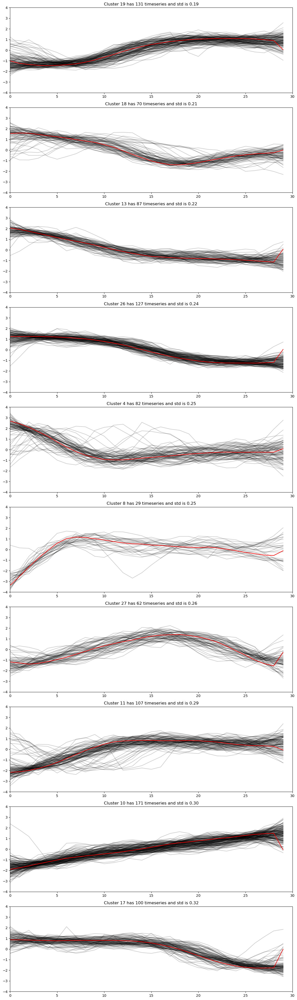

In [6]:
model = kshape_cluster(df, n_clusters=28, plot_n_best=10, column_value='open', period=30, rolling_period=6, train_sample=2000, column_time='begin', step=10)

the size of initial sample: (20476, 30)
the size of random sample: (2000, 30, 1)

preview of 1 time series:
[[ 1.00955287]
 [ 0.74801067]
 [ 0.35046654]
 [-0.05753928]
 [-0.69570223]
 [-1.30248012]
 [-1.68956257]
 [-1.89879632]
 [-2.04525995]
 [-1.77325607]
 [-1.33386518]
 [-0.93632105]
 [-0.43416004]
 [ 0.09938603]
 [ 0.60154704]
 [ 0.58062367]
 [ 0.78985742]
 [ 0.98862949]
 [ 0.94678274]
 [ 0.86308924]
 [ 0.41323667]
 [ 0.14123278]
 [-0.07846266]
 [-0.06800097]
 [-0.00523084]
 [ 0.27723472]
 [ 0.78985742]
 [ 1.15601649]
 [ 1.34432687]
 [ 1.21878662]]
Init 1
0.015 --> 0.014 --> 0.014 --> 0.014 --> 0.014 --> 0.014 --> 0.014 --> 
Init 2
Resumed because of empty cluster
Init 2
Resumed because of empty cluster
Init 2
0.013 --> 0.013 --> 
Init 3
0.014 --> 0.014 --> 0.014 --> 


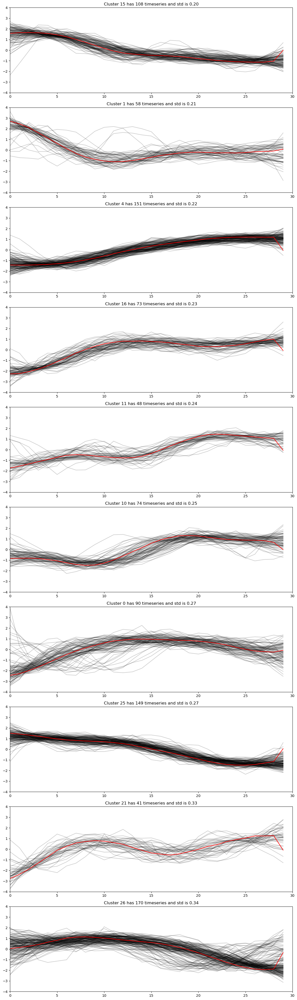

In [27]:
model = kshape_cluster(df, n_clusters=28, plot_n_best=10, column_value='open', period=30, rolling_period=6, train_sample=2000, column_time='begin', step=10)

In [ ]:
# 4, 25, 10 - хорошие кластеры 

In [29]:
model.inertia_

0.012522466647331438

In [30]:
model.get_params()

{'init': 'random',
 'max_iter': 100,
 'n_clusters': 28,
 'n_init': 3,
 'random_state': 0,
 'tol': 1e-06,
 'verbose': True}

In [31]:
# Save model
model.to_hdf5('../models/ks_trained_3.hdf5')
## Load model
#trained_ks = KShape.from_hdf5('./ks_trained.hdf5')
## Use loaded model to make predictions
#y_pred = trained_ks.predict(X_train)

лучше использовать последнюю модель, а еще лучше попробовать получить новые, изменяя train_sample и n_clusters

предыдущие модели **(ks_trained_1.hdf5, ks_trained_2.hdf5) были подвержены переобучению!** туда выборка набиралась с повторением, и по сути кластеры состояли из повторившихся временных рядов, что плохо отражает реальное многообразие временных рядов

для выбора новых сочетаний может пригодиться информация о моих ручных тестах, о лучше конечно как-то автоматизировать выбор:

- 0.05 bad
- 0.025 bad
- 0.02 bad
- 0.015 little better than 0.013
- 0.014 - used for model 3 **(28 clusters/2000 sample = 0.014)**
- 0.013 norm (result better than 0.01)
- 0.01 norm